# Analyze the overall spatial distribution and arrangement of MGEs

Dataset: 2024_01_10_bmgshort

## Setup

In [959]:
import os
import re
import gc
import sys
import glob
import yaml
import numpy as np
import pandas as pd
from tqdm import tqdm
from time import time, sleep
import aicspylibczi as aplc
import matplotlib.pyplot as plt
from scipy.cluster import hierarchy
from collections import defaultdict
from skimage.feature import peak_local_max
from matplotlib_scalebar.scalebar import ScaleBar
from sklearn.cluster import AgglomerativeClustering
from scipy.spatial.distance import squareform, pdist
from skimage.segmentation import watershed, relabel_sequential
from skimage.measure import label, regionprops_table, regionprops

import cv2
import libpysal as ps
import pointpats.quadrat_statistics as qs
from pointpats import PointPattern
from pointpats import distance_statistics as dst
from pointpats import PoissonPointProcess as csr
from pointpats.window import Window, poly_from_bbox, as_window


In [675]:
dir(dst)

['DStatistic',
 'Envelopes',
 'F',
 'Fenv',
 'FtestResult',
 'G',
 'Genv',
 'GtestResult',
 'J',
 'Jenv',
 'JtestResult',
 'K',
 'Kenv',
 'KtestResult',
 'L',
 'Lenv',
 'LtestResult',
 'TREE_TYPES',
 '__all__',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 '_area',
 '_build_best_tree',
 '_k_neighbors',
 '_prepare',
 '_prepare_hull',
 '_ripley_dispatch',
 '_ripley_test',
 'f',
 'f_test',
 'g',
 'g_test',
 'interpolate',
 'j',
 'j_test',
 'k',
 'k_test',
 'l',
 'l_test',
 'namedtuple',
 'numpy',
 'poisson',
 'spatial',
 'warnings']

In [2]:
cluster = '/fs/cbsuvlaminck2/'
workdir = '/workdir/bmg224/manuscripts/mgefish/code/spatial_distribution_analysis'
os.chdir(cluster + workdir)
os.getcwd()

'/fs/cbsuvlaminck2/workdir/bmg224/manuscripts/mgefish/code/spatial_distribution_analysis'

In [3]:
config_fn = cluster + "/workdir/bmg224/manuscripts/mgefish/code/bmg_plasmids_imaging/agglomerative_clustering/config_240110.yaml"  # relative path to config file from workdir

with open(config_fn, "r") as f:
    config = yaml.safe_load(f)

In [54]:
%load_ext autoreload
%autoreload 2

sys.path.append(cluster + config['pipeline_path'] + '/' + config['functions_path'])
import fn_general_use as fgu
import image_plots as ip
# import segmentation_func as sf
# import fn_hiprfish_classifier as fhc
# import fn_spectral_images as fsi

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


ModuleNotFoundError: No module named 'neighbor2d'

In [4]:
# Get filenames from directories
raw_dir = cluster + config["data_dir"] + "/*[y0-9].czi"
# raw_dir = config["data_dir"] + "/*" + config["laser_regex"]
fns = glob.glob(raw_dir)
fns_base = [os.path.split(f)[1] for f in fns]
group_names = [re.sub("_2024\w+.czi", "", s) for s in fns_base]
# print('HERE-->', shifts_fns)
group_names = np.sort(np.unique(group_names))
m_size = group_names.shape[0]
dict_group_czifns_all = defaultdict(list)
for g in group_names:
    for s in fns:
        if g in s:
            dict_group_czifns_all[g].append(s)
dict_group_czifns_all = {g: sorted(s) for g, s in dict_group_czifns_all.items()}
dict_group_czifns_all

{'2024_01_10_bmgshort_slide_bmg_fov_01': ['/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_07_40.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_10_48.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_13_55.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_17_03.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_17_03_airy.czi',
  '/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_01_2024_01_10__18_30_12.czi'],
 '2024_01_10_bmgshort_slide_bmg_fov_02': ['/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imagi

In [65]:
def subplot_square_images(im_list, subplot_dims, im_inches=5, cmaps=(), clims=(), zoom_coords=(), scalebar_resolution=0, axes_off=True, discrete=()):
    sd1, sd2 = subplot_dims
    figsize=(sd2*im_inches,sd1*im_inches)
    # figsize=(sd2*im_inches,1.02375*sd1*im_inches)
    fig, axes = plt.subplots(sd1,sd2, figsize=figsize)
    for i, (ax, im) in enumerate(zip(fig.axes, im_list)):
        cmap = cmaps[i] if cmaps else 'inferno'
        im_ = im[~np.isnan(im)]
        clim = clims[i] if clims else (np.min(im_), np.max(im_))
        clim = clim if clim else (np.min(im_), np.max(im_))
        if cmap:
            ax.imshow(im, cmap=cmap, clim=clim, interpolation="none")
        else:
            ax.imshow(im, clim=clim)
        zc = zoom_coords if zoom_coords else (0,im.shape[0],0,im.shape[1])
        ax.set_ylim(zc[1],zc[0])
        ax.set_xlim(zc[2],zc[3])
        if axes_off:
            ax.set_axis_off()
        if i == 0 and scalebar_resolution:
            scalebar = ScaleBar(scalebar_resolution, 'um', frameon = False, color = 'white', box_color = 'white')
            plt.gca().add_artist(scalebar)
    plt.subplots_adjust(wspace=0,hspace=0,left=0,right=1,bottom=0,top=1)
    discrete = discrete if discrete else np.zeros((len(im_list),))
    cbars = []
    for im, cl, cmp, d in zip(im_list, clims, cmaps, discrete):
        if cmp:
            fig2 = plt.figure(figsize=(9, 1.5))
            if d:
                vals = np.sort(np.unique(im))
                vals = vals[~np.isnan(vals)]
                vals = vals if len(cl)==0 else vals[(vals>=cl[0]) & (vals<=cl[1])]
                cbar = get_discrete_colorbar(vals, d)
            else:
                if cl:
                    image=plt.imshow(im, cmap=cmp, clim=cl)
                else:
                    image=plt.imshow(im, cmap=cmp)
                plt.gca().set_visible(False)
                cbar = plt.colorbar(image,orientation="horizontal")
        cbars.append(fig2)
    return(fig, fig.axes, cbars)


def general_plot(xlabel='', ylabel='', ft=12, dims=(5,3), col='k', lw=1, pad=0):
    fig, ax = plt.subplots(figsize=(dims[0], dims[1]),  tight_layout={'pad': pad})
    for i in ax.spines:
        ax.spines[i].set_linewidth(lw)
    ax.spines['top'].set_color(col)
    ax.spines['bottom'].set_color(col)
    ax.spines['left'].set_color(col)
    ax.spines['right'].set_color(col)
    ax.tick_params(direction='in', labelsize=ft, color=col, labelcolor=col)
    ax.set_xlabel(xlabel, fontsize=ft, color=col)
    ax.set_ylabel(ylabel, fontsize=ft, color=col)
    ax.patch.set_alpha(0)
    return(fig, ax)


def segment_no_lne(image, mask):
    seeds = label(peak_local_max(image, min_distance=1, indices=False))
    watershed_input = (-image)*mask
    seg = watershed(watershed_input, seeds, mask=mask, watershed_line=True)
    return label(seg)


def measure_regionprops(seg, raw=None):
    if isinstance(raw, type(None)):
        raw = np.zeros(seg.shape)
    sp_ = regionprops(seg, intensity_image=raw)
    properties = [
        "label",
        "centroid",
        "area",
        "max_intensity",
        "mean_intensity",
        "min_intensity",
        "bbox",
        "major_axis_length",
        "minor_axis_length",
        "orientation",
        "eccentricity",
        "perimeter",
    ]
    df = pd.DataFrame([])
    for p in properties:
        df[p] = [s[p] for s in sp_]
    for j in range(2):
        df["centroid-" + str(j)] = [r["centroid"][j] for i, r in df.iterrows()]
    for j in range(4):
        df["bbox-" + str(j)] = [r["bbox"][j] for i, r in df.iterrows()]
    # regions = regionprops_table(seg, intensity_image = raw,
    #                             properties=['label','centroid','area','max_intensity',
    #                             'mean_intensity','min_intensity', 'bbox',
    #                             'major_axis_length', 'minor_axis_length',
    #                             'orientation','eccentricity','perimeter'])
    # return pd.DataFrame(regions)
    return df


def norm(im, c=['min','max']):
    mn = np.min(im) if c[0] == 'min' else c[0]
    mx = np.max(im) if c[1] == 'max' else c[1]
    im = np.clip(im, mn, mx)
    return (im - mn) / (mx - mn)

## Load images

In [410]:
sn = '2024_01_10_bmgshort_slide_bmg_fov_04'

Get image filename

In [6]:
mge_raw_fn = dict_group_czifns_all[sn][4]
mge_raw_fn

'/fs/cbsuvlaminck2//workdir/Data/bmg224/2024/brc_imaging/2024_01_10_bmgshort/2024_01_10_bmgshort_slide_bmg_fov_04_2024_01_10__19_50_19_airy.czi'

Load images

In [15]:
czi_mge = aplc.CziFile(mge_raw_fn)
czi_mge.get_dims_shape()[0]

{'X': (0, 2024),
 'Y': (0, 2024),
 'Z': (0, 1),
 'C': (0, 2),
 'T': (0, 1),
 'M': (0, 16),
 'V': (0, 1),
 'B': (0, 1)}

Plot images

In [16]:
M_mge = 16

In [17]:
def reshape_aics_image(m_img):
    '''
    Given an AICS image with just XY and CHannel,
    REshape into shape (X,Y,C)
    '''
    img = np.squeeze(m_img)
    img = np.transpose(img, (1,2,0))
    return img

In [18]:
raws_mge = []
for m_s in range(M_mge):
    im, sh = czi_mge.read_image(M=m_s)
    im = reshape_aics_image(im)
    raws_mge.append(im)

(<Figure size 1440x1440 with 16 Axes>,
 [<AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>],
 [])

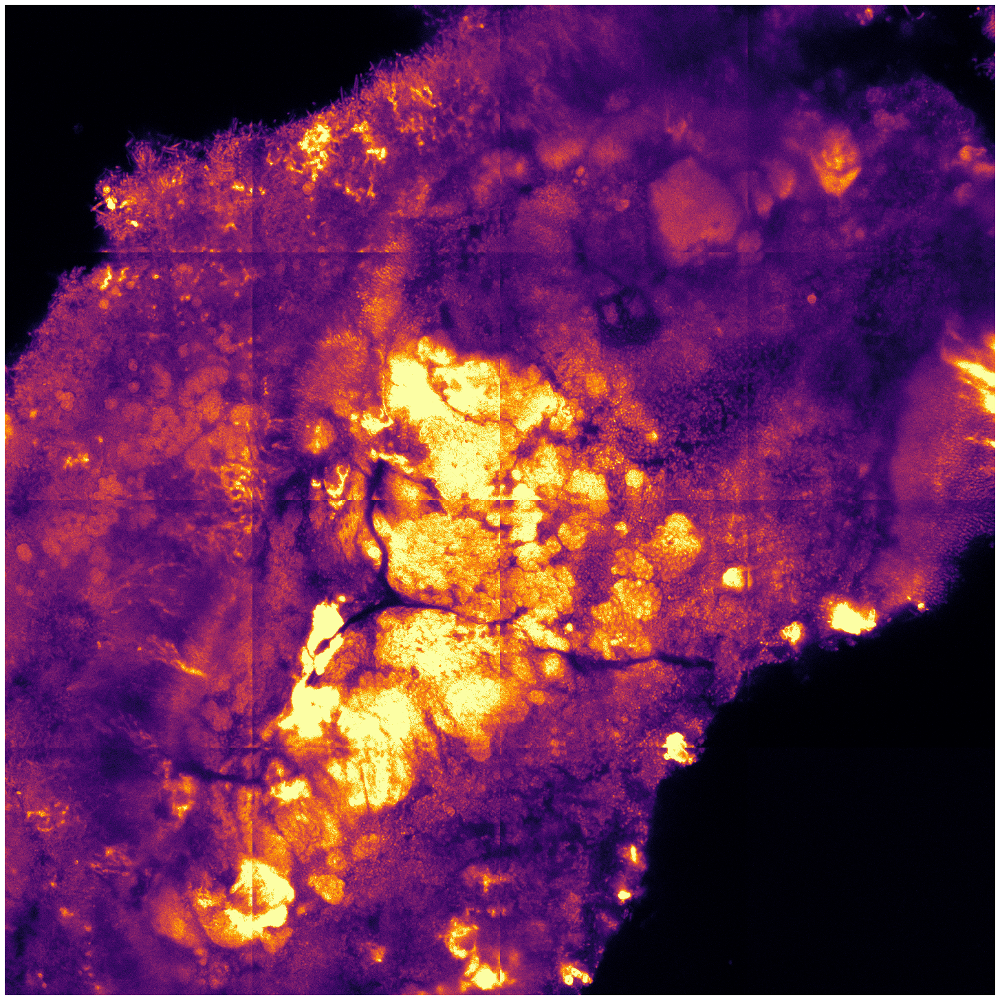

In [67]:
cell_raws = [im[:,:,0] for im in raws_mge]
clims_cell = [(100,2000)]*16
subplot_square_images(cell_raws, (4,4), clims=clims)

In [37]:
cbars

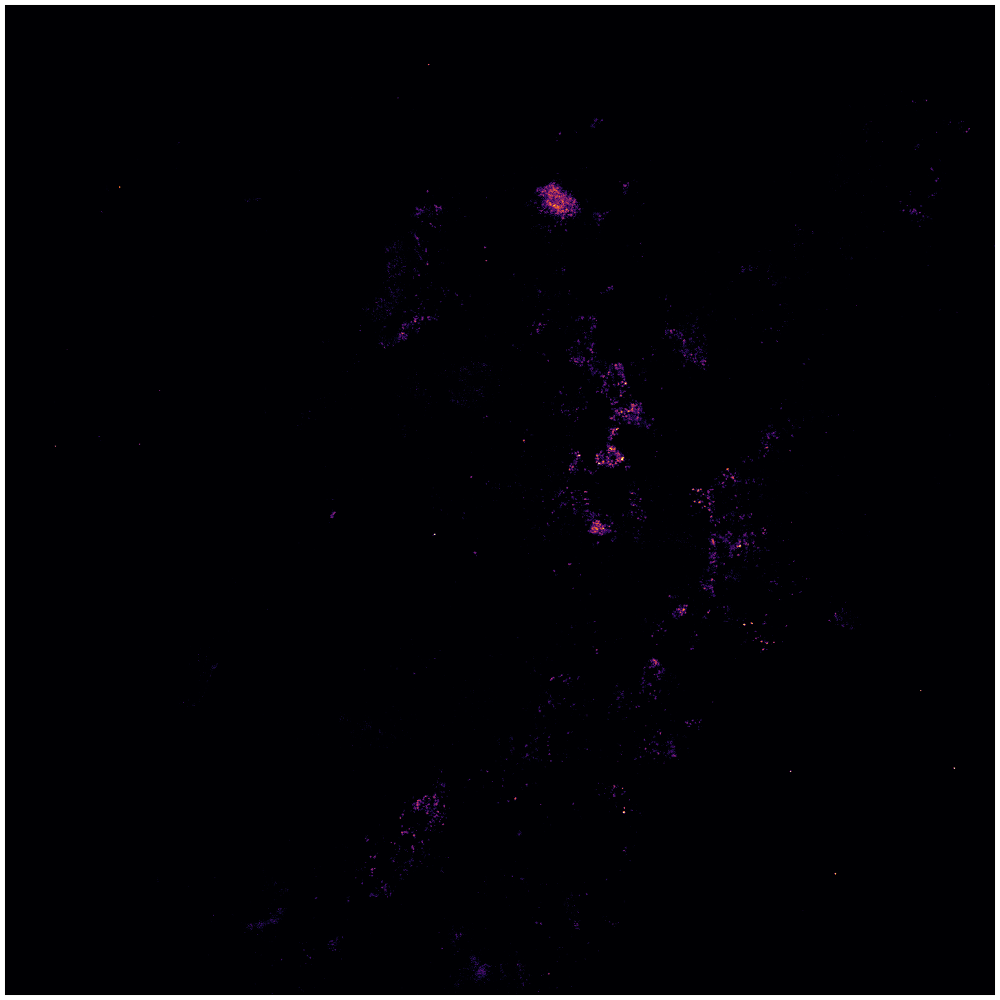

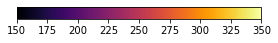

In [40]:
mge_raws = [im[:,:,1] for im in raws_mge]
clims = [(150,350)]*16
cmaps = ['inferno']*16
fig, axs, cbars = subplot_square_images(mge_raws, (4,4), clims=(clims), cmaps=cmaps)
for i, c in enumerate(cbars):
    if i > 0:
        plt.figure(c)
        plt.close()

## Get spot props

Bakcground threshold

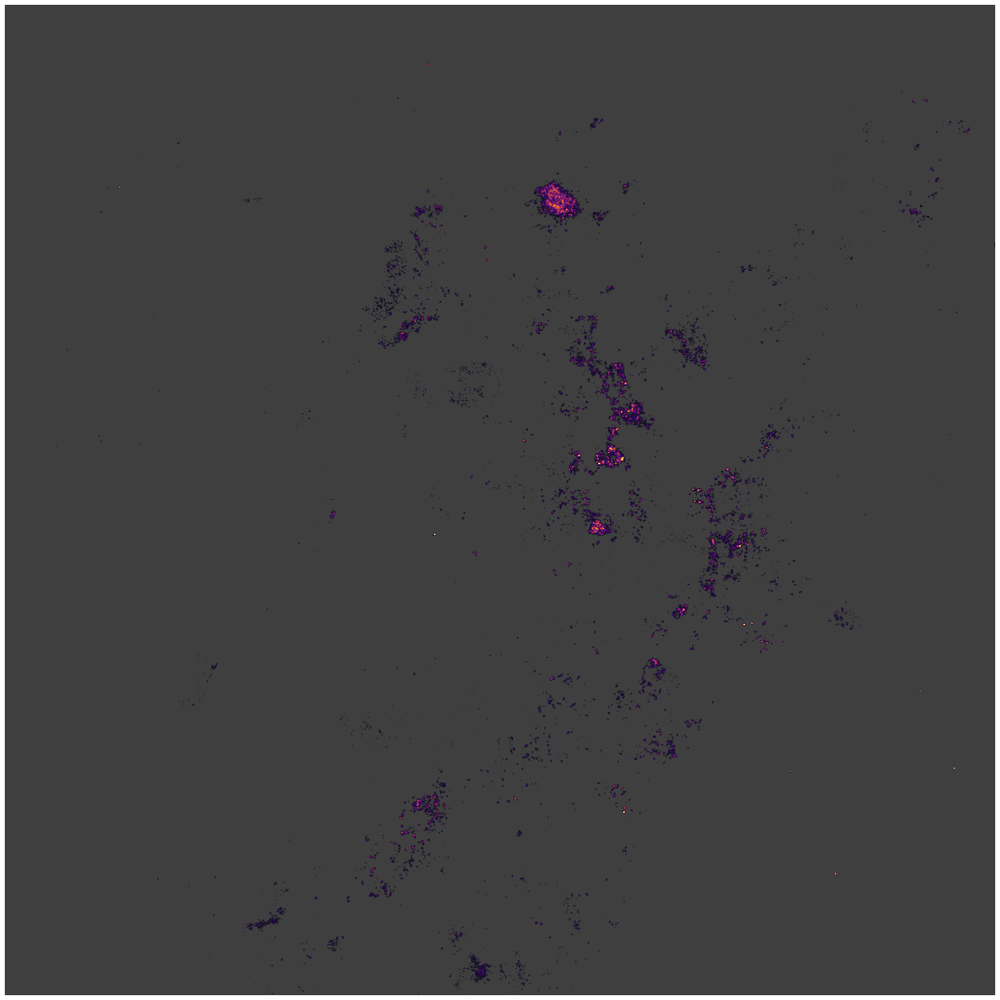

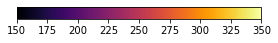

In [41]:
thresh_0 = 160

mge_masks_0 = [r > thresh_0 for r in raws_mge_spot]

mge_masks_0_plot0 = [r * m for m, r in zip(mge_raws, mge_masks_0)]
mge_masks_0_plot1 = [np.dstack([0.5 * (~m)] * 4) for m in mge_masks_0]

fig, axs, cbars = subplot_square_images(mge_masks_0_plot0, (4,4), clims=(clims), cmaps=cmaps)
for ax, p in zip(axs, mge_masks_0_plot1):
    ax.imshow(p)
for i, c in enumerate(cbars):
    if i > 0:
        plt.figure(c)
        plt.close()


Plot pixel intensities

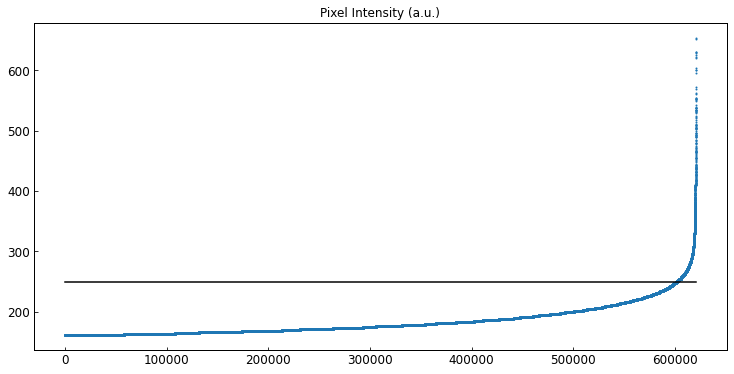

In [95]:
thresh_1 = 250

mge_masks_0_pix = np.hstack([r[m] for r, m in zip(mge_raws, mge_masks_0)])

fig, ax = general_plot(dims=(10,5))
x = np.arange(mge_masks_0_pix.shape[0])
y = np.sort(mge_masks_0_pix)
ax.scatter(x,y, s=1)
ax.set_title('Pixel Intensity (a.u.)')
ax.plot([0,x.shape[0]], [thresh_1]*2, 'k')

New background threshold

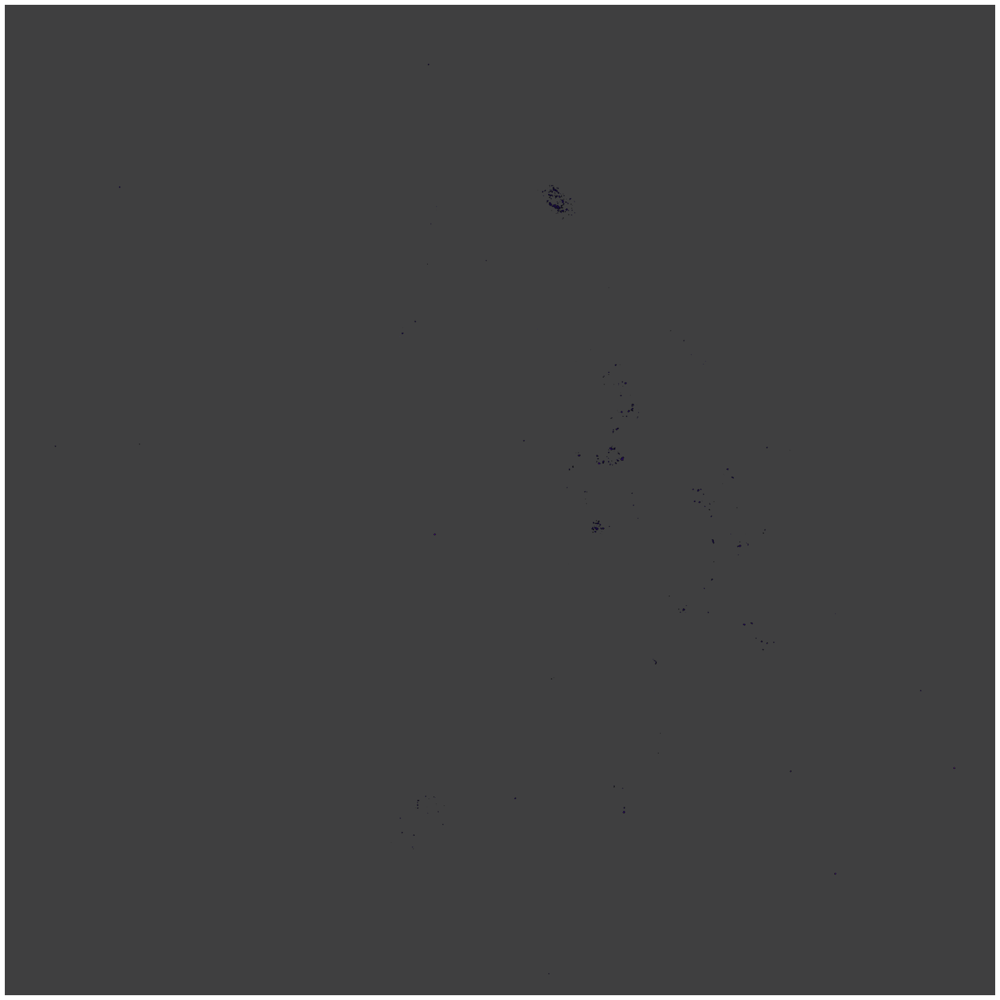

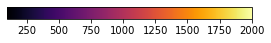

In [96]:
mge_masks_1 = [r > thresh_1 for r in raws_mge_spot]

mge_masks_1_plot0 = [r * m for r, m in zip(mge_raws, mge_masks_1)]
mge_masks_1_plot1 = [np.dstack([0.5 * (~m)] * 4) for m in mge_masks_1]

fig, axs, cbars = subplot_square_images(mge_masks_1_plot0, (4,4), clims=(clims), cmaps=cmaps)
for ax, p in zip(axs, mge_masks_1_plot1):
    ax.imshow(p)
for i, c in enumerate(cbars):
    if i > 0:
        plt.figure(c)
        plt.close()

Segmentation

/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: indices argument is deprecated and will be removed in version 0.20. To avoid this warning, please do not use the indices argument. Please see peak_local_max documentation for more details.
  """Entry point for launching an IPython kernel.


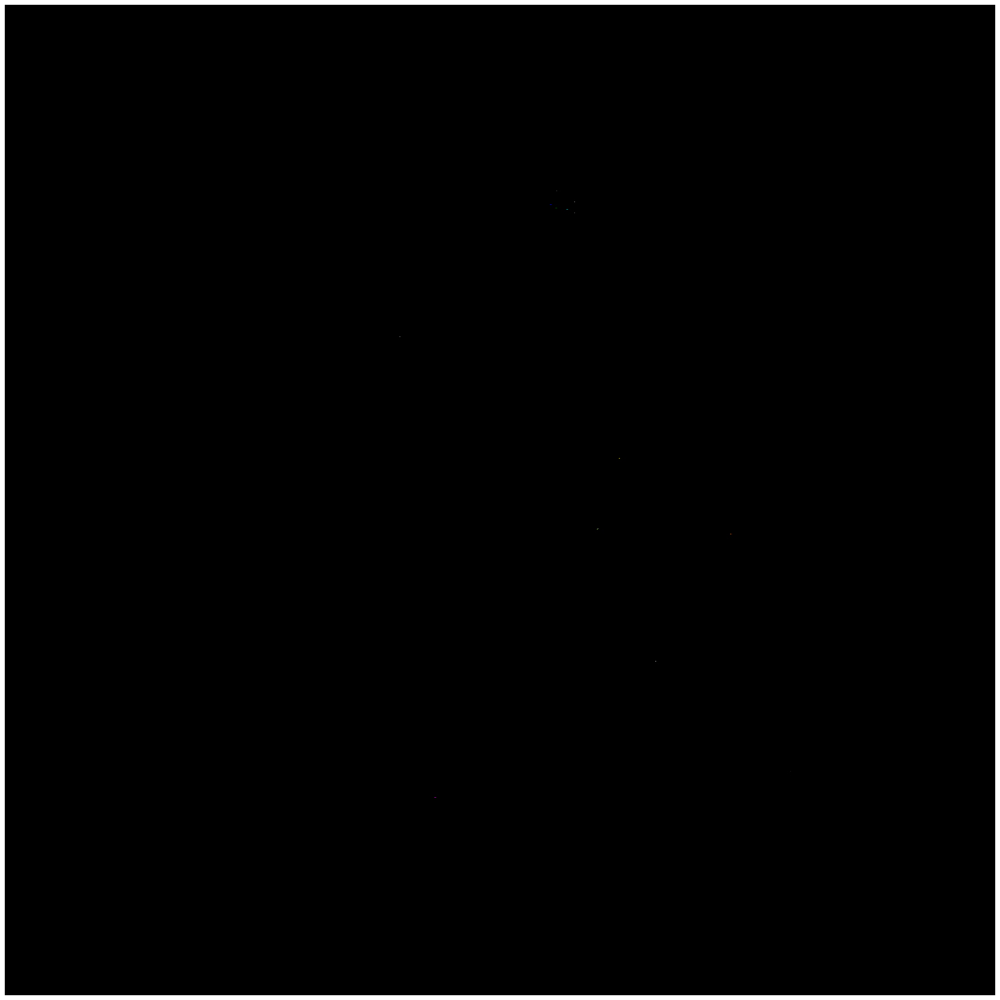

In [97]:
mge_segs = [label(peak_local_max(r*m, min_distance=1, indices=False)) for r, m in zip(mge_raws, mge_masks_1)]
mge_segs_rgb = [ip.seg2rgb(s) for s in mge_segs]
fig, axs, cbars = subplot_square_images(mge_segs_rgb, (4,4))


Measure props

In [98]:
mge_props = [measure_regionprops(s, r) for s, r in zip(mge_segs, mge_raws)]

Plot spots on image

Wrote: /fs/cbsuvlaminck2//workdir/bmg224/manuscripts/mgefish/outputs/spatial_distribution_analysis/2024_01_10_bmgshort_slide_bmg_fov_04/2024_01_10_bmgshort_slide_bmg_fov_04_raw.png


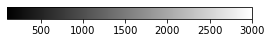

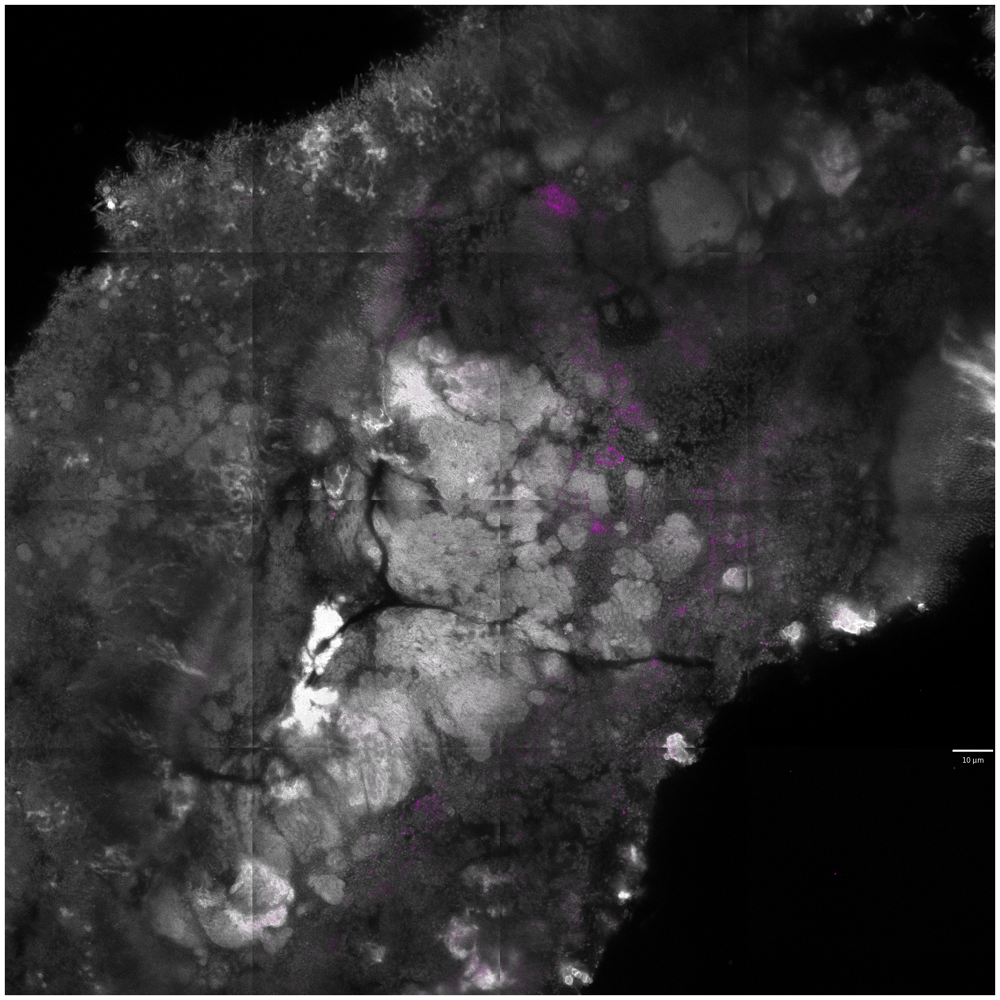

In [960]:
# mge_raws_rgb = [np.dstack([r,np.zeros_like(r),r,r]) for r in mge_raws]
mge_raws_rgb = []
clims_mge = [(100,350)] * 16
for r, cl in zip(mge_raws, clims_mge):
    r_norm = norm(r, cl)
    r_rgb = np.dstack([r_norm, np.zeros_like(r_norm), r_norm, r_norm])
    mge_raws_rgb.append(r_rgb)

clims_cell = [(100,3000)] * 16
cmaps_cell = ['gray'] * 16
fig, axs, cbars = subplot_square_images(cell_raws, (4,4), clims=(clims_cell), cmaps=cmaps_cell, scalebar_resolution=mge_umpix)
for ax, p in zip(axs, mge_raws_rgb):
    ax.imshow(p)
for i, c in enumerate(cbars):
    if i > 0:
        plt.figure(c)
        plt.close()

output_dir = cluster + '/workdir/bmg224/manuscripts/mgefish/outputs/spatial_distribution_analysis/' + sn
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
    print('Made dir:', output_dir)
out_bn = output_dir + '/' + sn + '_raw'

dpi = mge_raws[0].shape[0] / 5

plt.figure(fig)
ip.save_png_pdf(out_bn, dpi=dpi)
print('Wrote:', out_bn + '.png')

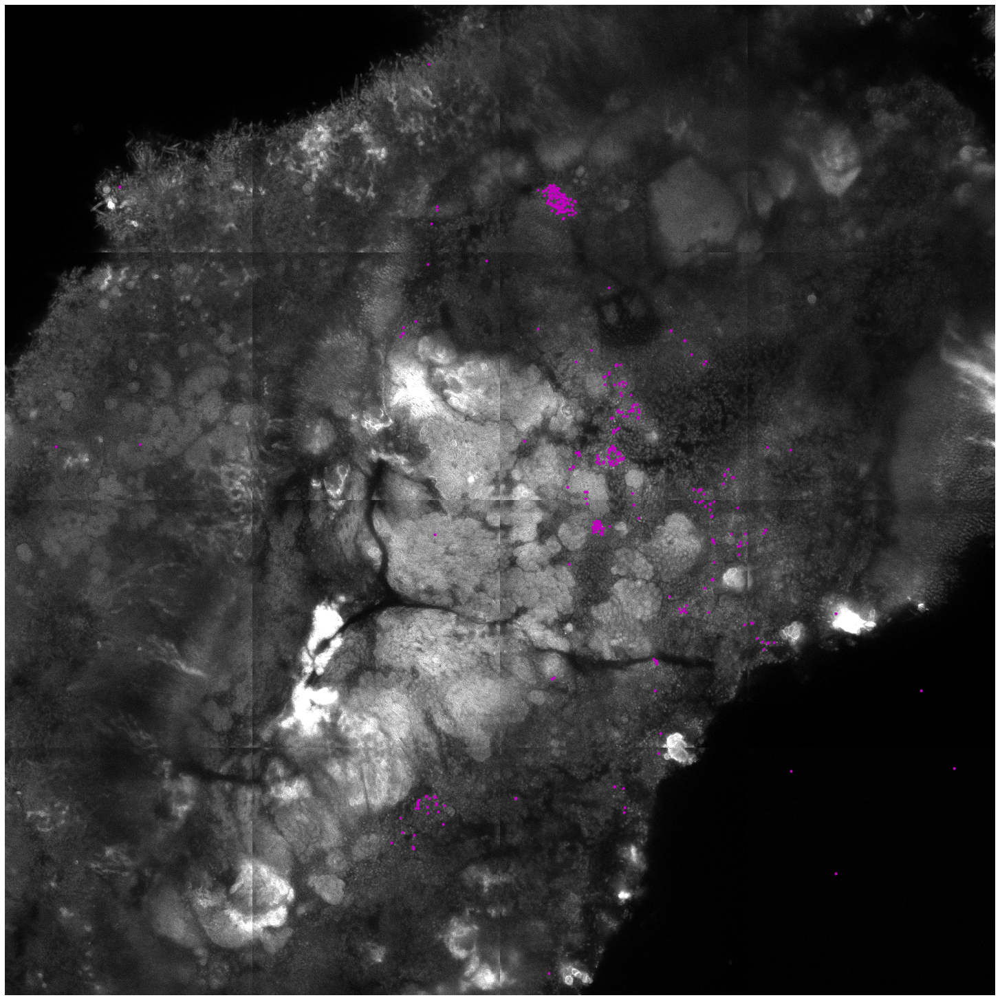

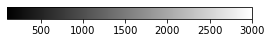

In [100]:
s = 10

mge_coords = [np.array([list(s) for s in p['centroid'].values]) for p in mge_props]
fig, axs, cbars = subplot_square_images(cell_raws, (4,4), clims=(clims_cell), cmaps=cmaps_cell)
for ax, c in zip(axs, mge_coords):
    if len(c) > 0:
        c = c if len(c.shape) > 1 else c[None,:]
        ax.scatter(c[:,1], c[:,0], color='m', s=s)

for i, c in enumerate(cbars):
    if i > 0:
        plt.figure(c)
        plt.close()

Get absolute coordinates for spots

In [114]:
tile_shape = (4,4)

mge_coords_adj = []
for m, im in enumerate(mge_raws):
    r = m // tile_shape[1]
    c = m - r * tile_shape[0]
    adj = np.array(im.shape) * np.array([r, c])
    crds = mge_coords[m]
    if len(crds) > 0:
        crds_adj = crds + adj
    else:
        crds_adj = np.array([])
    mge_coords_adj.append(crds_adj)

In [144]:
dict_m_sid_crd = {}
p0 = 0
spot_ids_order = []
mge_coords_adj_order = []
for m, p in enumerate(mge_props):
    crd = [list(c) for c in p['centroid'].values]
    sid = p.label.values + p0
    dict_m_sid_crd[m] = dict(zip(sid, crd))

    crds_adj = mge_coords_adj[m]
    mge_coords_adj_order += [c for c in crds_adj]
    spot_ids_order += sid.tolist()

    p0 += len(sid)

len(spot_ids_order), len(mge_coords_adj_order)

(405, 405)

In [128]:
# spot_ids_order = []
# mge_coords_adj_order = []
# for m, p in enumerate(mge_props):
#     sid = p.label.values.tolist()
#     spot_ids_order += sid
#     crds_adj = mge_coords_adj[m]
#     mge_coords_adj_order += [c for c in crds_adj]

# len(spot_ids_order), len(mge_coords_adj_order)

(405, 405)

## Simulate random spots

Generate full image

(<Figure size 2160x2160 with 1 Axes>,
 <Axes:>,
 [<Figure size 2160x216 with 2 Axes>,
  <matplotlib.colorbar.Colorbar at 0x7fd024820ad0>])

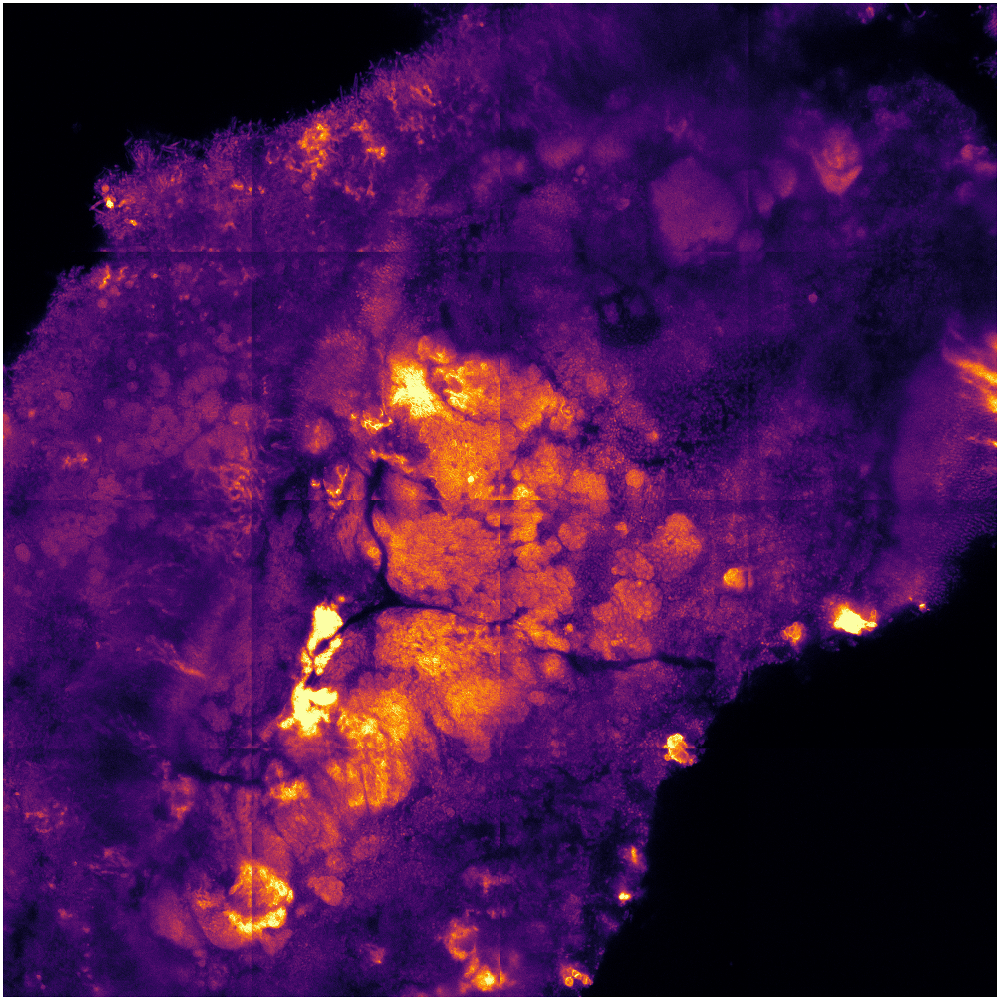

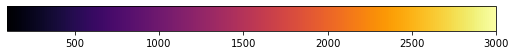

In [173]:
r_full = 0
c_full = 0
for m, im in enumerate(cell_raws):
    r = m // tile_shape[1]
    c = m - r * tile_shape[0]
    if r == 0:
        c_full += im.shape[1]
    if c == 0:
        r_full += im.shape[0]

cell_raw_full = np.zeros((r_full, c_full))
for m, im in enumerate(cell_raws):
    r = m // tile_shape[1]
    c = m - r * tile_shape[0]
    rsh, csh = im.shape
    ulr = r*rsh
    ulc = c*csh
    cell_raw_full[ulr: ulr + rsh, ulc: ulc + csh] = im

ip.plot_image(cell_raw_full, clims=clims_cell[0], cmap='inferno', im_inches=30)

Get cell foreground

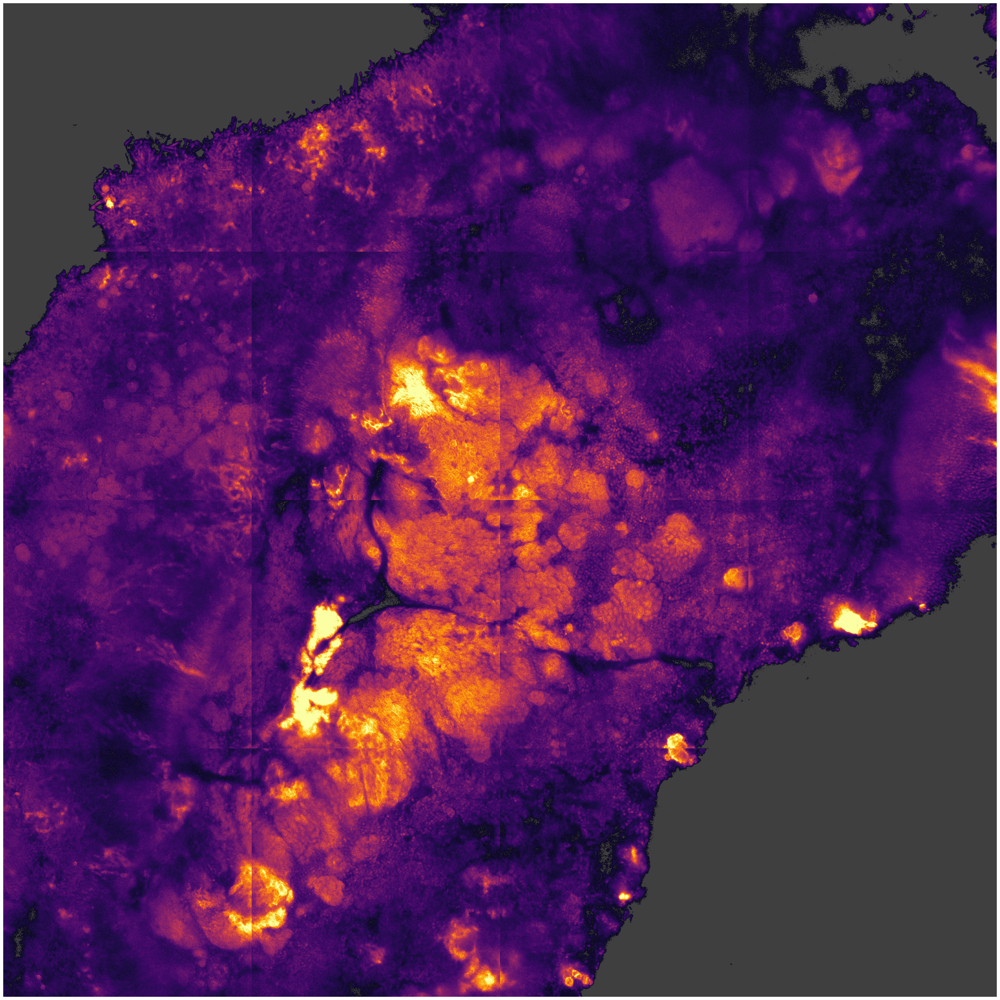

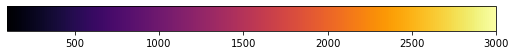

In [530]:
thresh_cell = 300

cell_mask = cell_raw_full > thresh_cell

plot0 = cell_raw_full * cell_mask
plot1 = np.dstack([0.5 * (~cell_mask)] * 4)
fig, ax, cbar = ip.plot_image(plot0, clims=clims_cell[0], cmap='inferno', im_inches=30)
ax.imshow(plot1)

In [531]:
contours, _ = cv2.findContours(cell_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
polygons = []

for obj in contours:
    coords = []
        
    for point in obj:
        coords.append(int(point[0][0]))
        coords.append(int(point[0][1]))

    polygons.append(coords)

NameError: name 'cv2' is not defined

Simulate random spots

In [187]:
pci_inds.shape

(52318309,)

In [198]:
# Set downsample value and sim number 
nsim = 1000
downsample_pix = 10

# Get pixel inds and inds for pixel inds
n_spots = len(mge_coords_adj_order)
pix_cell = np.where(cell_mask)
pix_cell_inds = np.hstack([a[:,None] for a in pix_cell])
pci_inds = np.arange(0, pix_cell_inds.shape[0], downsample_pix)

# Test speed
n = 10
ts = []
for i in range(n):
    t0 = time()
    np.random.choice(pci_inds, n_spots, replace=False)
    t1 = time()
    ts.append(t1-t0)
print('mean seconds per iteration:',np.mean(ts), ', stdev:' np.std(ts))
print('minutes for sim:', nsim*np.mean(ts) / 60)

0.1901689052581787 0.005715002715958358
3.1694817543029785


In [199]:
# Simulate
mge_spot_sim = []
pci_inds = np.arange(0, pix_cell_inds.shape[0], downsample_pix)
for i in tqdm(range(nsim)):
    choice_inds = np.random.choice(pci_inds, n_spots, replace=False)
    mge_spot_sim.append(pix_cell_inds[choice_inds])



100%|██████████| 1000/1000 [03:05<00:00,  5.39it/s]


### Define pysal points object

In [ ]:
crf_shp = cell_raw_full.shape

# parts = [
#     [0,0],
#     [0,cell_raw_full.shape[0]],
#     [cell_raw_full.shape[1],cell_raw_full.shape[0]],
#     [cell_raw_full.shape[1],0]
# ]
# parts = np.array(to_ccf(parts))
# # parts = to_ccf(corners)
# window = Window(parts)

bbox=[0,0,crf_shp[0],crf_shp[1]]
poly = poly_from_bbox(bbox)
window = as_window(poly)

In [596]:
mge_pp = PointPattern(mge_coords_adj_order)
# mge_pp = PointPattern(mge_coords_adj_order, window=window)
mge_pp.summary()

Point Pattern
405 points
Bounding rectangle [(487.0,413.0), (7920.0,7760.0)]
Area of window: 54610251.0
Intensity estimate for window: 7.4161900482750025e-06
             x            y
0  1487.333333   937.666667
1  1491.000000   940.000000
2   487.000000  3463.000000
3  1649.000000  3528.000000
4  1679.000000  3528.000000


/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1492: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1208: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)



## Radius -> graph

Define nearest neighbors in radius

Create graph 

Identify graph fragments 

Measure the physical size of fragments

Measure the distance between fragments

## LISA hotspots

Get cell segmentation

Get cell locations

Construct graph

Get values at each node

Measure LISA

Plot LISA

Define hotspots

Measure hotspot size

Measure distance between hotspots

## L function

Get distance matrix for all points 

In [791]:
mge_umpix = 0.02995
nn_dists = mge_pp.nnd.squeeze()
nn_dists_um = nn_dists * mge_umpix
int_1um = int(np.max(nn_dists) / np.max(nn_dists_um))
ints_1um = int(np.max(nn_dists_um))

In [877]:
realizations = csr(mge_pp.window, mge_pp.n, 100, asPP=True) # simulate CSR 100 times
reals = realizations.realizations

/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:103: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)


Histogram

In [1070]:
save = True

In [1067]:
# dims=(10,5)
dims=(2,1)
ft=6
col='k'
lw=1

/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:39: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:40: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use

Wrote: /fs/cbsuvlaminck2//workdir/bmg224/manuscripts/mgefish/outputs/spatial_distribution_analysis/2024_01_10_bmgshort_slide_bmg_fov_04/2024_01_10_bmgshort_slide_bmg_fov_04_nn_hist.png


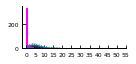

In [969]:

xt_max = 60
col_obs=(1,0,1)
alpha_bar=0.05
col_mean = 'tab:blue'
col_pct = 'tab:orange'
# col_low = 'tab:green'
# col_mean = (0.95,0.95,0)
ls_pct = 'dotted'
pct = 0.05

bins=int(np.max(nn_dists_um))

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)

hist_n = []
for i in range(len(reals)):
    r = reals[i]
    n, binedges, _ = ax.hist(r.nnd, bins=bins, color=col, alpha=alpha_bar)
    hist_n.append(n)

binedges = np.array(binedges)
xmean = binedges[:-1] + np.diff(binedges) / 2
hist_n = np.vstack(hist_n)
hist_mean = np.mean(hist_n, axis=0)
ax.plot(xmean, hist_mean, color=col_mean, lw=lw)

hist_std = np.std(hist_n, axis=0)
# ax.plot(xmean, hist_mean + 2 * hist_std, color=col_mean, lw=lw, ls=ls_std)
# ax.plot(xmean, hist_mean - 2 * hist_std, color=col_mean, lw=lw, ls=ls_std)


res = hist_n
res_srt = np.sort(res,axis=0)
nres = len(res)
low = res_srt[np.int(nres * pct/2.)]
high = res_srt[np.int(nres * (1-pct/2.))]
ax.plot(xmean, low, color=col_mean, lw=lw, ls=ls_pct)
ax.plot(xmean, high, color=col_mean, lw=lw, ls=ls_pct)

ax.hist(nn_dists, bins=bins, color=col_obs)

# xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# ylim = ax.get_ylim()
# ax.set_ylim(1,ylim[1])
# ax.set_yscale('log')
# _ = ax.set_yticks([1,10,100], labels=[1,10,100])
if save:
    output_dir = cluster + '/workdir/bmg224/manuscripts/mgefish/outputs/spatial_distribution_analysis/' + sn
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        print('Made dir:', output_dir)
    out_bn = output_dir + '/' + sn + '_nn_hist'
    ip.save_png_pdf(out_bn)
    print('Wrote:', out_bn + '.png')

Cumulative distribution

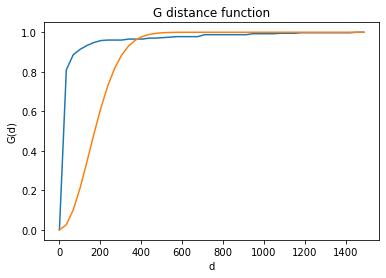

In [793]:
gp1 = dst.G(mge_pp, ints_1um)
fig = gp1.plot()

In [796]:
x_max = np.max(nn_dists)

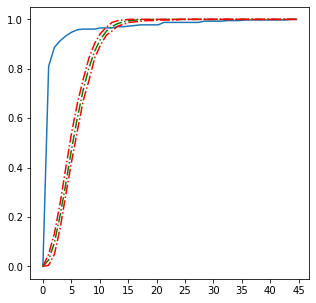

In [797]:
dims = (5,5)

Genv = dst.Genv(mge_pp, intervals=ints_1um, realizations=realizations)
Genv.plot()
plt.gcf().set_figwidth(dims[0])
plt.gcf().set_figheight(dims[1])
ax = plt.gca()
ax.get_legend().remove()
xlim = ax.get_xlim()
xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
ax.set_xticks(xticks, labels=xlab)
_ = ax.set_xticks(xticks)
ax.xaxis.label.set_visible(False)
ax.yaxis.label.set_visible(False)
ax.title.set_visible(False)
# ax.xaxis.set_visible(False)
# ax.set_xlabel('Distance (μm)')
# ax.set_xlabel(False)
# ax.set_xlabel('Probability that nearest neighbor distance is  (μm)')
# ax.set_title(False)

In [798]:
Genv.d

array([   0.        ,   33.84635056,   67.69270112,  101.53905168,
        135.38540224,  169.2317528 ,  203.07810336,  236.92445392,
        270.77080447,  304.61715503,  338.46350559,  372.30985615,
        406.15620671,  440.00255727,  473.84890783,  507.69525839,
        541.54160895,  575.38795951,  609.23431007,  643.08066063,
        676.92701119,  710.77336175,  744.61971231,  778.46606287,
        812.31241342,  846.15876398,  880.00511454,  913.8514651 ,
        947.69781566,  981.54416622, 1015.39051678, 1049.23686734,
       1083.0832179 , 1116.92956846, 1150.77591902, 1184.62226958,
       1218.46862014, 1252.3149707 , 1286.16132126, 1320.00767182,
       1353.85402237, 1387.70037293, 1421.54672349, 1455.39307405,
       1489.23942461])

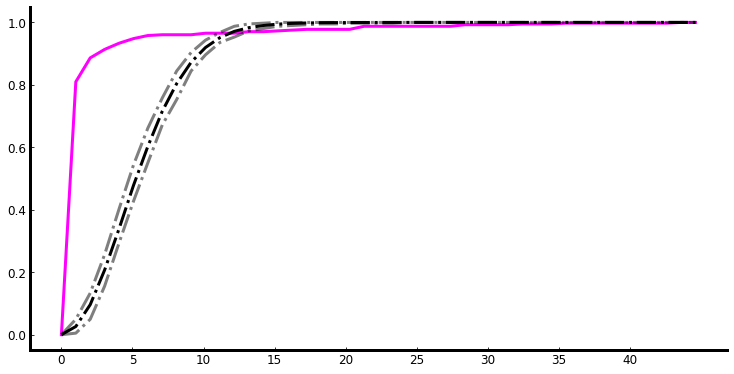

In [862]:

alpha_mean=1
alpha_p=0.5
ls_sim = '-.'

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)
x = Genv.d
ax.plot(x, Genv.observed[:,1], lw=lw, color=col_obs)
ax.plot(x, Genv.mean, lw=lw, color=col, alpha=alpha_mean, ls=ls_sim)
ax.plot(x, Genv.low, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)
ax.plot(x, Genv.high, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

In [914]:
Gres = np.array([Genv.calc(reals[p]) for p in reals])
Gresval = Gres[:,:,-1]

Wrote: /fs/cbsuvlaminck2//workdir/bmg224/manuscripts/mgefish/outputs/spatial_distribution_analysis/2024_01_10_bmgshort_slide_bmg_fov_04/2024_01_10_bmgshort_slide_bmg_fov_04_Gfunc.png


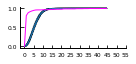

In [1072]:

alpha_sim = 0.1
lw_sim = 1

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)
x = Genv.d
for Gr in Gresval:
    ax.plot(x, Gr, lw=lw_sim, color=col, alpha=alpha_sim)

ax.plot(x, Genv.low, lw=lw, color=col_mean, ls=ls_pct)
ax.plot(x, Genv.high, lw=lw, color=col_mean, ls=ls_pct)
ax.plot(x, Genv.mean, lw=lw, color=col_mean)
ax.plot(x, Genv.observed[:,1], lw=lw, color=col_obs)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

if save:
    out_bn = output_dir + '/' + sn + '_Gfunc'
    ip.save_png_pdf(out_bn)
    print('Wrote:', out_bn + '.png')

# ax.set_xlim(0,15/mge_umpix)

L function

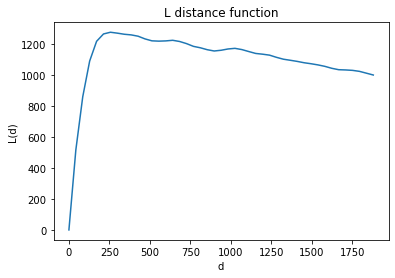

In [800]:
lp1 = dst.L(mge_pp, intervals=ints_1um)
lp1.plot()

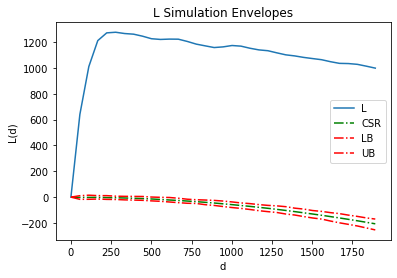

In [801]:
lenv = dst.Lenv(mge_pp, intervals=int_1um, realizations=realizations)
lenv.plot()

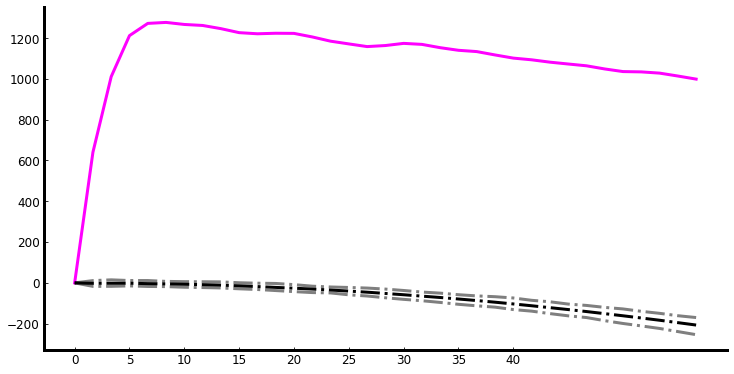

In [864]:

env = lenv

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)
x = env.d
ax.plot(x, env.observed[:,1], lw=lw, color=col_obs)
ax.plot(x, env.mean, lw=lw, color=col, alpha=alpha_mean, ls=ls_sim)
ax.plot(x, env.low, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)
ax.plot(x, env.high, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

Pair correlation function

In [803]:
int_10um, int_5um, int_1um

(330, 165, 33)

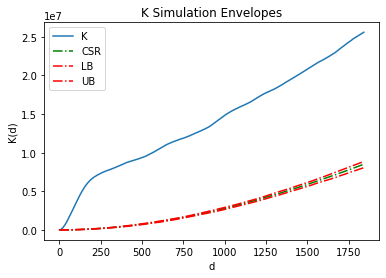

In [824]:
ints_05um = ints_1um*2
ints_025um = ints_1um*4
ints_01um = ints_1um*10

Kenv = dst.Kenv(mge_pp, intervals=ints_01um, realizations=realizations)
Kenv.plot()

In [825]:
def pcf(K, h):
    dKdh = np.diff(K) / np.diff(h)
    return dKdh / (2 * h[1:] * np.pi)

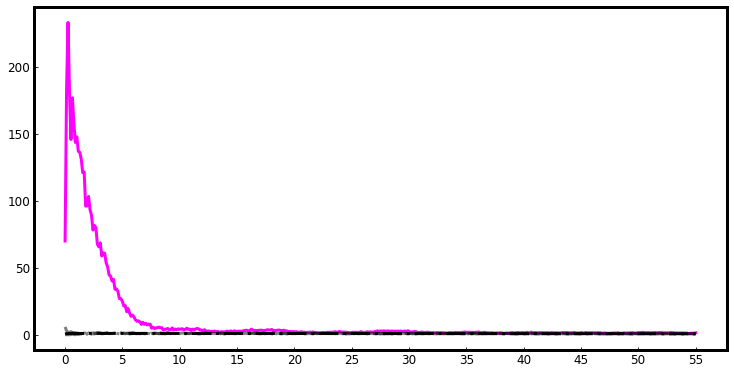

In [826]:
Robs = pcf(Kenv.observed[:,1], Kenv.d)
Rmean = pcf(Kenv.mean, Kenv.d)
Rlow = pcf(Kenv.low, Kenv.d)
Rhigh = pcf(Kenv.high, Kenv.d)

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)

x = Kenv.d[:-1]
ax.plot(x, Robs, lw=lw, color=col_obs)
ax.plot(x, Rmean, lw=lw, color=col, alpha=alpha_mean, ls=ls_sim)
ax.plot(x, Rlow, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)
ax.plot(x, Rhigh, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)

(0.0, 10.0)

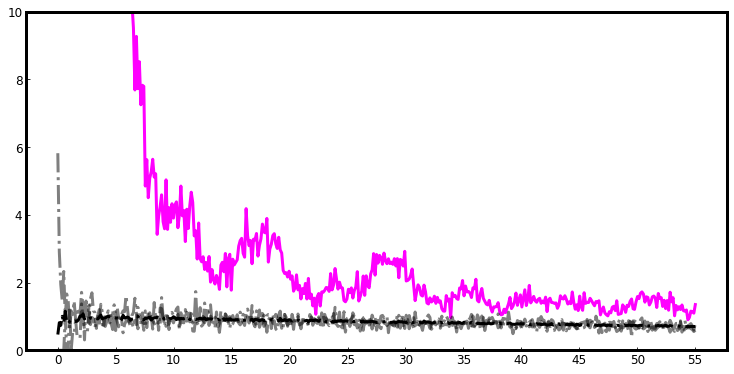

In [827]:
Robs = pcf(Kenv.observed[:,1], Kenv.d)
Rmean = pcf(Kenv.mean, Kenv.d)
Rlow = pcf(Kenv.low, Kenv.d)
Rhigh = pcf(Kenv.high, Kenv.d)

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)

x = Kenv.d[:-1]
ax.plot(x, Robs, lw=lw, color=col_obs)
ax.plot(x, Rmean, lw=lw, color=col, alpha=alpha_mean, ls=ls_sim)
ax.plot(x, Rlow, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)
ax.plot(x, Rhigh, lw=lw, color=col, alpha=alpha_p, ls=ls_sim)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)

ax.set_ylim(0,10)

In [941]:
# Calculate all realizations
reals = realizations.realizations
Kres = np.array([Kenv.calc(reals[p]) for p in reals])
Kresval = Kres[:,:,-1]
R_sim = [pcf(r, Kenv.d) for r in Kresval]
R_sim = np.vstack(R_sim)
Rmean = np.mean(R_sim, axis=0)


/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:13: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  del sys.path[0]
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:14: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to revie

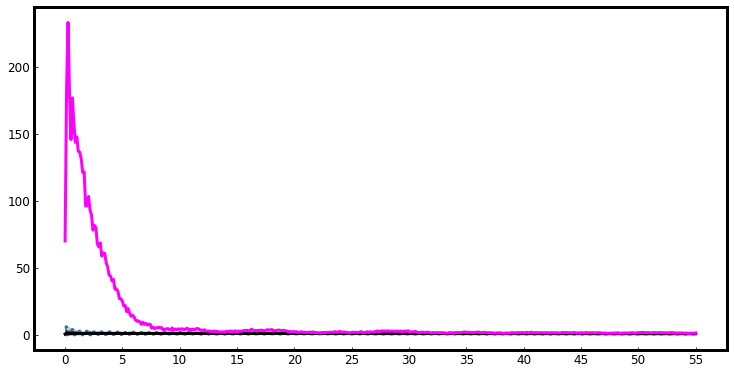

In [928]:
alpha_sim = 0.1
lw_sim = 1

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)

x = Kenv.d[:-1]
for Rs in R_sim:
    ax.plot(x, Rs, lw=lw_sim, color=col, alpha=alpha_sim)

res = R_sim
res_srt = np.sort(res,axis=0)
nres = len(res)
low = res_srt[np.int(nres * pct/2.)]
high = res_srt[np.int(nres * (1-pct/2.))]
ax.plot(x, low, color=col_mean, lw=lw, ls=ls_pct)
ax.plot(x, high, color=col_mean, lw=lw, ls=ls_pct)

ax.plot(x, Rmean, lw=lw, color=col_mean, alpha=alpha_mean)

ax.plot(x, Robs, lw=lw, color=col_obs)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)



/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:13: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  del sys.path[0]
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:14: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to revie

(0.0, 10.0)

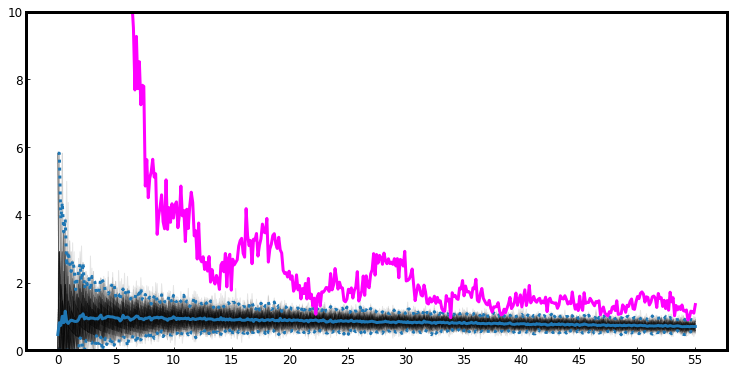

In [932]:
alpha_sim = 0.1
lw_sim = 1

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)

x = Kenv.d[:-1]
for Rs in R_sim:
    ax.plot(x, Rs, lw=lw_sim, color=col, alpha=alpha_sim)

res = R_sim
res_srt = np.sort(res,axis=0)
nres = len(res)
low = res_srt[np.int(nres * pct/2.)]
high = res_srt[np.int(nres * (1-pct/2.))]
ax.plot(x, low, color=col_mean, lw=lw, ls=ls_pct)
ax.plot(x, high, color=col_mean, lw=lw, ls=ls_pct)

ax.plot(x, Rmean, lw=lw, color=col_mean, alpha=alpha_mean)

ax.plot(x, Robs, lw=lw, color=col_obs)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)

ax.set_ylim(0,10)


/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:13: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  del sys.path[0]
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:14: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to revie

Wrote: /fs/cbsuvlaminck2//workdir/bmg224/manuscripts/mgefish/outputs/spatial_distribution_analysis/2024_01_10_bmgshort_slide_bmg_fov_04/2024_01_10_bmgshort_slide_bmg_fov_04_pcf_log.png


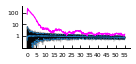

In [971]:
alpha_sim = 0.1
lw_sim = 1

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)

x = Kenv.d[:-1]
for Rs in R_sim:
    ax.plot(x, Rs, lw=lw_sim, color=col, alpha=alpha_sim)

res = R_sim
res_srt = np.sort(res,axis=0)
nres = len(res)
low = res_srt[np.int(nres * pct/2.)]
high = res_srt[np.int(nres * (1-pct/2.))]
ax.plot(x, low, color=col_mean, lw=lw, ls=ls_pct)
ax.plot(x, high, color=col_mean, lw=lw, ls=ls_pct)

ax.plot(x, Rmean, lw=lw, color=col_mean, alpha=alpha_mean)

ax.plot(x, Robs, lw=lw, color=col_obs)

xlim = ax.get_xlim()
# xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)

ax.set_yscale('log')
_ = ax.set_yticks([1,10,100], labels=[1,10,100])

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

if save:
    out_bn = output_dir + '/' + sn + '_pcf_log'
    ip.save_png_pdf(out_bn)
    print('Wrote:', out_bn + '.png')

Radial distribution

In [938]:
def rdf(K, h, lamb):
    dKdh = np.diff(K) / np.diff(h)
    return dKdh * lamb

In [944]:
lamb

7.4161900482750025e-06

In [947]:
lamb = mge_pp.lambda_window
h = Kenv.d
Fobs = rdf(Kenv.observed[:,1], h, lamb)
Fmean = rdf(Kenv.mean, h, lamb)
Flow = rdf(Kenv.low, h, lamb)
Fhigh = rdf(Kenv.high, h, lamb)

# Calculate all realizations
F_sim = [rdf(r, h, lamb) for r in Kresval]
F_sim = np.vstack(F_sim)
# Rmean = np.mean(R_sim, axis=0)

Wrote: /fs/cbsuvlaminck2//workdir/bmg224/manuscripts/mgefish/outputs/spatial_distribution_analysis/2024_01_10_bmgshort_slide_bmg_fov_04/2024_01_10_bmgshort_slide_bmg_fov_04_rdf.png


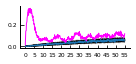

In [972]:
alpha_sim = 0.1
lw_sim = 1

fig, ax = ip.general_plot(dims=dims, ft=ft, col=col, lw=lw)

x = Kenv.d[:-1]
for Fs in F_sim:
    ax.plot(x, Fs, lw=lw_sim, color=col, alpha=alpha_sim)

# res = R_sim
# res_srt = np.sort(res,axis=0)
# nres = len(res)
# low = res_srt[np.int(nres * pct/2.)]
# high = res_srt[np.int(nres * (1-pct/2.))]
ax.plot(x, Flow, color=col_mean, lw=lw, ls=ls_pct)
ax.plot(x, Fhigh, color=col_mean, lw=lw, ls=ls_pct)

ax.plot(x, Fmean, lw=lw, color=col_mean, alpha=alpha_mean)

ax.plot(x, Fobs, lw=lw, color=col_obs)

xlim = ax.get_xlim()
xt_max = int(xlim[1] * mge_umpix)
xlab = np.arange(0, xt_max, 5)
xticks = xlab / mge_umpix
_ = ax.set_xticks(xticks, labels=xlab)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

if save:
    out_bn = output_dir + '/' + sn + '_rdf'
    ip.save_png_pdf(out_bn)
    print('Wrote:', out_bn + '.png')


## Semivariogram

Define function to get spots given lag and lag range

Get spots for each lag

Calculate empirical semivariogram values for each lag

## Nearest neighbor distances

Get nearest neighbors

Plot histogram of distances

Simulate random spots and calculate mean nearest neighbor

Plot simulation vs observed

Plot histogram of simulation close to mean

## Quadrat counts analysis

Defiine window

In [641]:
a = 0
n = 0
while a < 1:
    print(n,end='\r')
    n += 1

KeyboardInterrupt: 

In [326]:
mge_qh = qs.QStatistic(mge_pp, shape='hexagon',lh=200)

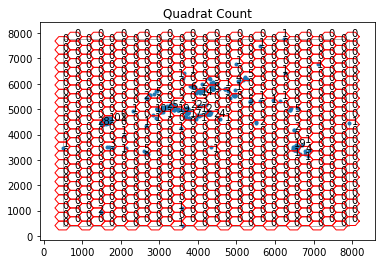

572


In [328]:
mge_qh.plot()
print(mge_qh.mr.num)

Get chi square value

In [168]:
mge_qh.chi2, mge_qh.chi2_pvalue

(20219.483950617283, 0.0)

Calculate values for varying quadrat size

In [379]:
hex_lengths = np.arange(200,2000,10)

mge_chis = []
for lh in hex_lengths:
    qh = qs.QStatistic(mge_pp, shape='hexagon', lh=lh)
    mge_chis.append(qh.chi2)

Simulate random spots and get arrays of mean square and chi square values with varying quadrat size

In [380]:
mge_chis_sim = []
for s in tqdm(mge_spot_sim[:20]):
    s_pp = PointPattern(s)
    chis = []
    for lh in hex_lengths:
        qh = qs.QStatistic(s_pp, shape='hexagon', lh=lh)
        chis.append(qh.chi2)
    mge_chis_sim.append(chis)


  0%|          | 0/20 [00:00<?, ?it/s]/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1492: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1208: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
100%|██████████| 20/20 [00:18<00:00,  1.10it/s]


Plot chi square values vs simulation

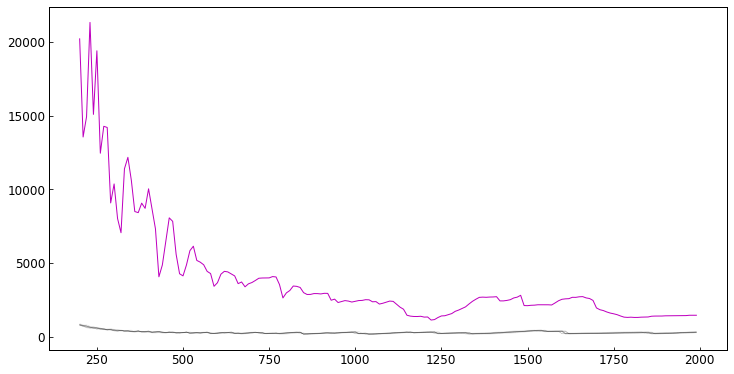

In [381]:
dims=(10,5)
col='k'
ft=12
sim_alpha=0.1
sim_lw=0.5
lw=1

fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)
hex_lengths = 
for chis in mge_chis_sim:
    ax.plot(hex_lengths, chis, color='k', alpha=sim_alpha, lw=sim_lw)
ax.plot(hex_lengths, mge_chis, color='m', lw=lw)
# ax.set_xlim(50,1000)
# ax.set_ylim(0,10000)

Get mean square counts value

In [219]:
qh = qs.HexagonM(mge_pp, lh=lh)
Nir = np.array(list(qh.point_location_sta().values()))
SSr = np.sum(Nir**2) / len(Nir)
SSr


172.0857142857143

In [389]:
hex_lengths = np.arange(1,3000,100)

mge_MSr = []
for lh in hex_lengths:
    qh = qs.HexagonM(mge_pp, lh=lh)
    Nir = np.array(list(qh.point_location_sta().values()))
    MSr = np.sum(Nir**2) / len(Nir)
    mge_MSr.append(MSr)

In [257]:
mge_MSr_sim = []
for s in tqdm(mge_spot_sim[:20]):
    s_pp = PointPattern(s)
    MSrs = []
    for lh in hex_lengths:
        qh = qs.HexagonM(s_pp, lh=lh)
        Nir = np.array(list(qh.point_location_sta().values()))
        MSr = np.sum(Nir**2) / len(Nir)
        MSrs.append(MSr)
    mge_MSr_sim.append(MSrs)

  0%|          | 0/20 [00:00<?, ?it/s]/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1492: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1208: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
100%|██████████| 20/20 [02:33<00:00,  7.68s/it]


Plot mean square values vs simulation

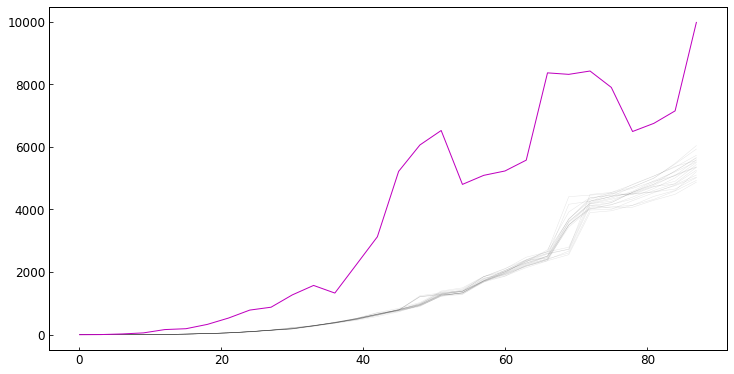

In [393]:
dims=(10,5)
col='k'
ft=12
sim_alpha=0.1
sim_lw=0.5
lw=1

fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)
x = hex_lengths * mge_umpix
for MSrs in mge_MSr_sim:
    ax.plot(x, MSrs, color='k', alpha=sim_alpha, lw=sim_lw)
ax.plot(x, mge_MSr, color='m', lw=lw)
# ax.set_xlim(0,250)

In [394]:
80**2 * 3 * 3**(1/2) / 2

16627.687752661222

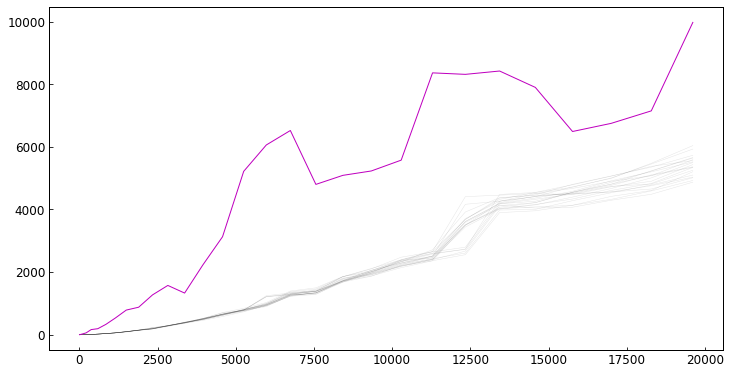

In [397]:
dims=(10,5)
col='k'
ft=12
sim_alpha=0.1
sim_lw=0.5
lw=1

hex_areas = 3 * (3**(1/2)) / 2 * ((hex_lengths * mge_umpix)**2)
fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)
for MSrs in mge_MSr_sim:
    ax.plot(hex_areas, MSrs, color='k', alpha=sim_alpha, lw=sim_lw)
ax.plot(hex_areas, mge_MSr, color='m', lw=lw)
# ax.set_xlim(0,250)

Plot distributions of spot counts

In [333]:
hex_lengths = np.arange(1,3000,100)

mge_Nir = []
for lh in hex_lengths:
    qh = qs.HexagonM(mge_pp, lh=lh)
    Nir = np.array(list(qh.point_location_sta().values()))
    mge_Nir.append(Nir)

In [334]:
np.where(hex_lengths == 101)

(array([1]),)

In [407]:
bins_

array([ 0.,  3.,  6.,  9., 12., 15., 18., 21., 24., 27., 30., 33., 36.,
       39., 42., 45., 48., 51., 54., 57., 60.])

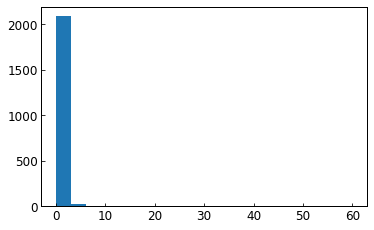

In [409]:
bins=20

lh = 101
area = 3 * (3**(1/2)) / 2 * lh**2
ind = np.where(hex_lengths == lh)[0][0]
# Nir = mge_Nir[ind] / area
Nir = mge_Nir[ind]
fig, ax = ip.general_plot()
hist, bins_, _ = ax.hist(Nir, bins=bins)
# plt.close()

# fig, ax = ip.general_plot()
# logbins = np.logspace(1,np.log10(bins_[-1]),len(bins_))
# ax.hist(Nir, bins=logbins)


In [ ]:
fig, ax = ip.general_plot()

ax.scatter()

(0.0, 100.0)

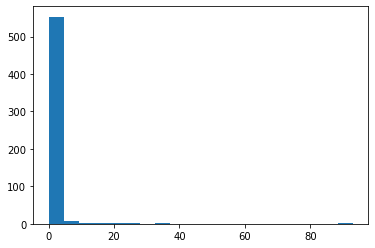

In [345]:
lh = 201
ind = np.where(hex_lengths == lh)[0][0]
area = 3 * (3**(1/2)) / 2 * lh**2
# Nir = mge_Nir[ind] / area
Nir = mge_Nir[ind]
plt.hist(Nir, bins=bins)
ax.set_ylim(0,100)


(0.0, 100.0)

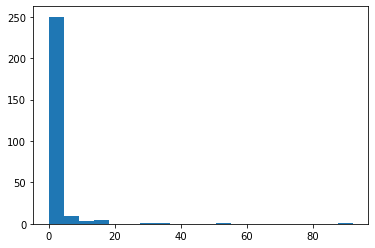

In [346]:
lh = 301
ind = np.where(hex_lengths == lh)[0][0]
area = 3 * (3**(1/2)) / 2 * lh**2
# Nir = mge_Nir[ind] / area
Nir = mge_Nir[ind]
plt.hist(Nir, bins=bins)
ax.set_ylim(0,100)

Text(0.5, 0, 'Hexagon edge length')

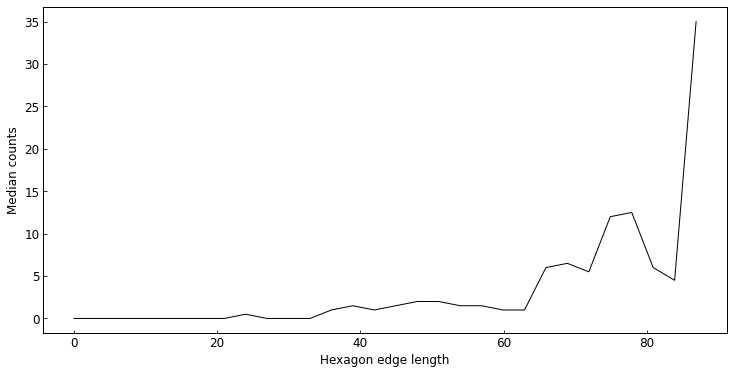

In [411]:
mge_Nir_med = [np.median(Nir) for Nir in mge_Nir]

fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)
x = hex_lengths * mge_umpix
ax.plot(x, mge_Nir_med, color='k', lw=lw)
ax.set_ylabel('Median counts')
ax.set_xlabel('Hexagon edge length')


Text(0.5, 0, 'Hexagon edge length')

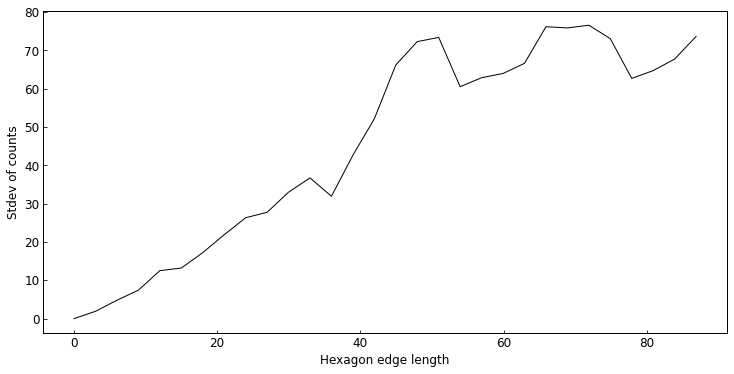

In [412]:
mge_Nir_std = [np.std(Nir) for Nir in mge_Nir]

fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)
x = hex_lengths * mge_umpix
ax.plot(x, mge_Nir_std, color='k', lw=lw)
ax.set_ylabel('Stdev of counts')
ax.set_xlabel('Hexagon edge length')

Plot actual MSr value

In [359]:
q = 8
crf_shp = np.array(cell_raw_full.shape)
crf_shp / 2**q, 2**q

(array([31.625, 31.625]), 256)

In [360]:
# count spots in successively larger quadrats vertical
mge_Nir2 = []
block_areas = []
edgelens = []
nr = (2**q, 2**q)
while nr[0] > 1 and nr[1] > 1:
    qh = qs.RectangleM(mge_pp, count_column=nr[0], count_row=nr[1])
    Nir = np.array(list(qh.point_location_sta().values()))
    mge_Nir2.append(Nir)
    edgesizes = crf_shp / np.array(nr)
    block_areas.append(int(edgesizes[0]*edgesizes[1]))
    edgelens.append(np.max(edgesizes))
    if nr[0] == nr[1]:
        nr = (nr[0]//2, nr[1])
    else:
        nr = (nr[0], nr[1]//2)
    


In [361]:
# count spots in successively larger quadrats horizontal
mge_Nir2h = []
nr = (2**q, 2**q)
while nr[0] > 1 and nr[1] > 1:
    qh = qs.RectangleM(mge_pp, count_column=nr[0], count_row=nr[1])
    Nir = np.array(list(qh.point_location_sta().values()))
    mge_Nir2h.append(Nir)
    if nr[0] == nr[1]:
        nr = (nr[0], nr[1]//2)
    else:
        nr = (nr[0]//2, nr[1])
    


In [382]:
mge_MSr2 = []
mge_MSr2h = []
for i in range(len(mge_Nir2) - 1):
    Nir = np.array(mge_Nir2[i])
    Ni2r = np.array(mge_Nir2[i + 1])
    SSr = 2 * np.sum(Nir**2) - np.sum(Ni2r**2)
    MSr = SSr / (2*2**q)
    # MSr = SSr / len(Nir)
    mge_MSr2.append(MSr)
    # horizontal
    Nir = np.array(mge_Nir2h[i])
    Ni2r = np.array(mge_Nir2h[i + 1])
    SSr = 2 * np.sum(Nir**2) - np.sum(Ni2r**2)
    MSr = SSr / (2*2**q)
    # MSr = SSr / len(Nir)
    mge_MSr2h.append(MSr)

In [383]:
# simulation measurement
mge_MSr2_sim_means = []
block_areas_sims = []
edgelens_sims = []
for s in tqdm(mge_spot_sim[:20]):
    s_pp = PointPattern(s)
    block_areas_sim = []
    edgelen_sim = []
    # Vertical
    mge_Nir2_sim = []
    nr = (2**q, 2**q)
    while nr[0] > 1 and nr[1] > 1:
        qh = qs.RectangleM(s_pp, count_column=nr[0], count_row=nr[1])
        Nir = np.array(list(qh.point_location_sta().values()))
        mge_Nir2_sim.append(Nir)
        edgesizes = crf_shp / np.array(nr)
        block_areas_sim.append(int(edgesizes[0]*edgesizes[1]))
        edgelen_sim.append(np.max(edgesizes))
        if nr[0] == nr[1]:
            nr = (nr[0]//2, nr[1])
        else:
            nr = (nr[0], nr[1]//2)
    # horizontal
    mge_Nir2h_sim = []
    nr = (2**q, 2**q)
    while nr[0] > 1 and nr[1] > 1:
        qh = qs.RectangleM(s_pp, count_column=nr[0], count_row=nr[1])
        Nir = np.array(list(qh.point_location_sta().values()))
        mge_Nir2h_sim.append(Nir)
        if nr[0] == nr[1]:
            nr = (nr[0], nr[1]//2)
        else:
            nr = (nr[0]//2, nr[1])

    # mean values
    mge_MSr2_sim = []
    mge_MSr2h_sim = []
    for i in range(len(mge_Nir2_sim) - 1):
        Nir = np.array(mge_Nir2_sim[i])
        Ni2r = np.array(mge_Nir2_sim[i + 1])
        SSr = 2 * np.sum(Nir**2) - np.sum(Ni2r**2)
        # MSr = SSr / len(Nir)
        MSr = SSr / 2**(2*q)
        mge_MSr2_sim.append(MSr)
        # horizontal
        Nir = np.array(mge_Nir2h_sim[i])
        Ni2r = np.array(mge_Nir2h_sim[i + 1])
        SSr = 2 * np.sum(Nir**2) - np.sum(Ni2r**2)
        # MSr = SSr / len(Nir)
        MSr = SSr / 2**(2*q)
        mge_MSr2h_sim.append(MSr)

    mge_MSr2_sim_mean = np.mean(np.vstack([mge_MSr2_sim, mge_MSr2h_sim]), axis=0)
    mge_MSr2_sim_means.append(mge_MSr2_sim_mean)
    block_areas_sims.append(block_areas_sim)
    edgelens_sims.append(edgelen_sim)

  0%|          | 0/20 [00:00<?, ?it/s]/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1492: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1208: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
100%|██████████| 20/20 [00:03<00:00,  6.39it/s]


/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:22: UserWarning: FixedFormatter should only be used together with FixedLocator


Text(0.5, 0, 'Block area (μm^2)')

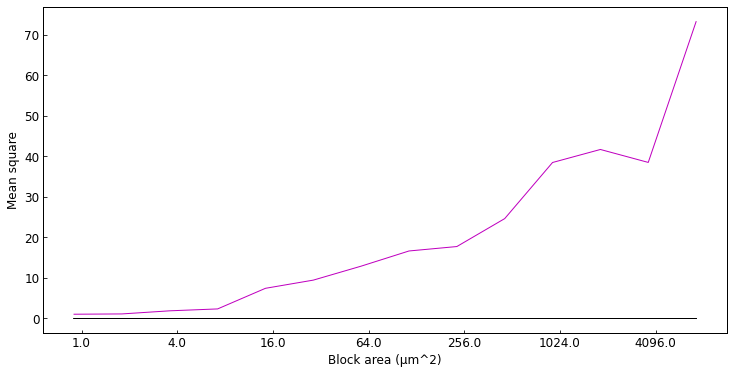

In [413]:
dims=(10,5)
col='k'
ft=12
sim_alpha=1
sim_lw=0.5
lw=1

mge_umpix = 0.02995

fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)
for x, MSrs in zip(block_areas_sims, mge_MSr2_sim_means):
    x = np.log2(np.array(x) * mge_umpix**2)[:-1]
    # x = (np.array(x) * mge_umpix)[:-1]
    ax.plot(x, MSrs, color='k', alpha=sim_alpha, lw=sim_lw)
# x = (np.array(edgelens) * mge_umpix)[:-1]
x = np.log2(np.array(block_areas) * mge_umpix**2)[:-1]
# ax.plot(x, mge_MSr2, color='r', lw=lw)
# ax.plot(x, mge_MSr2h, color='b', lw=lw)
mge_MSr2_mean = np.mean(np.vstack([mge_MSr2, mge_MSr2h]), axis=0)
ax.plot(x, mge_MSr2_mean, color='m', lw=lw)
labels = (2**np.array(ax.get_xticks()))
ax.set_xticklabels(labels)
# ax.set_xlim(0,8)
# ax.set_ylim(0,100)
ax.set_ylabel('Mean square')
ax.set_xlabel('Block area (μm^2)')

Hex version

In [399]:
mge_hex_SSrs = []
for i in range(len(mge_Nir) - 1):
    Nir = np.array(mge_Nir[i])
    Ni2r = np.array(mge_Nir[i + 1])
    Ar = hex_areas[i]
    A2r = hex_areas[i + 1]
    A_rat = A2r / Ar
    SSr = A_rat * np.sum(Nir**2) - np.sum(Ni2r**2)
    mge_hex_SSrs.append(SSr)


(-100000.0, 100000.0)

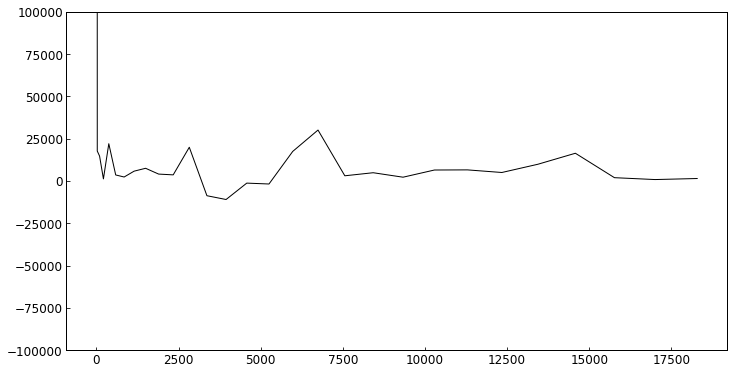

In [421]:
fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)

x = hex_areas[:-1]
y = mge_hex_SSrs
ax.plot(x, y, color='k', lw=lw)
ax.set_ylim(-100000, 100000)

Ratio of sum of squares vs ratio vs area

In [414]:
mge_Nir_Ar_rat = []
for i in range(len(mge_Nir) - 1):
    Nir = np.array(mge_Nir[i])
    Ni2r = np.array(mge_Nir[i + 1])
    Ar = hex_areas[i]
    A2r = hex_areas[i + 1]
    A_rat = A2r / Ar
    Nir_rat = np.sum(Ni2r**2) / np.sum(Nir**2)
    mge_Nir_Ar_rat.append(Nir_rat - A_rat)

(-1.0, 1.0)

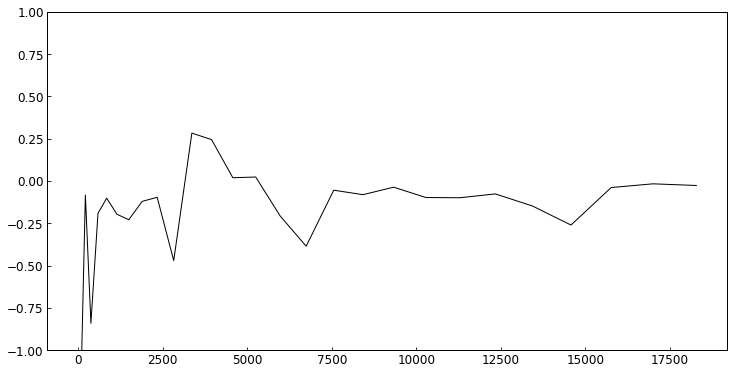

In [420]:
fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)

x = hex_areas[:-1]
y = mge_Nir_Ar_rat
ax.plot(x, y, color='k', lw=lw)
ax.set_ylim(-1,1)

### Try again with squares

Pick smallest squares

In [461]:

mge_pp.summary()
nrc0 = 202
edgelen0_um = crf_shp / nrc0 * mge_umpix
crf_shp_um = crf_shp * mge_umpix
crf_A_um = np.prod(crf_A_um)
crf_A_um, edgelen0_um

Point Pattern
405 points
Bounding rectangle [(487.0,413.0), (7920.0,7760.0)]
Area of window: 54610251.0
Intensity estimate for window: 7.4161900482750025e-06
             x            y
0  1487.333333   937.666667
1  1491.000000   940.000000
2   487.000000  3463.000000
3  1649.000000  3528.000000
4  1679.000000  3528.000000


(58794.22261504, array([1.20037228, 1.20037228]))

Pick step size for number of rows and columns

In [521]:
# crf_A_um = np.prod(crf_shp * mge_umpix)
# A_um_range = np.arange(1, crf_A_um, 100)
# edgelen_um_range = np.sqrt(A_um_range)
# nrc_range = crf_shp_um[0] // edgelen_um_range
# nrc_range
nrc_range = np.arange(nrc0,0,-1)
# nrc_range = [200,100,75,55,45,38,33,29,26,24,22,20,18,17] + np.arange(16,0,-1).tolist()
edgelens3_um =  / np.array(nrc_range)

edgelens3_um

array([  1.20037228,   1.20634428,   1.212376  ,   1.21846834,
         1.22462222,   1.23083858,   1.23711837,   1.24346256,
         1.24987216,   1.25634819,   1.26289167,   1.26950366,
         1.27618526,   1.28293757,   1.2897617 ,   1.29665882,
         1.30363011,   1.31067676,   1.3178    ,   1.32500109,
         1.33228132,   1.33964199,   1.34708444,   1.35461006,
         1.36222022,   1.36991638,   1.3777    ,   1.38557257,
         1.39353563,   1.40159075,   1.40973953,   1.41798363,
         1.42632471,   1.4347645 ,   1.44330476,   1.45194731,
         1.46069398,   1.46954667,   1.47850732,   1.48757791,
         1.49676049,   1.50605714,   1.51547   ,   1.52500126,
         1.53465316,   1.54442803,   1.55432821,   1.56435613,
         1.57451429,   1.58480523,   1.59523158,   1.60579603,
         1.61650133,   1.62735034,   1.63834595,   1.64949116,
         1.66078904,   1.67224276,   1.68385556,   1.69563077,
         1.70757183,   1.71968227,   1.73196571,   1.74

Count spots for each mesh

In [522]:
mge_Nir3 = []
block_areas3 = []
# edgelens3_um = []
for nrc in nrc_range:
    qh = qs.RectangleM(mge_pp, count_column=nrc, count_row=nrc)
    Nir = np.array(list(qh.point_location_sta().values()))
    mge_Nir3.append(Nir)
    # edgelen_um = crf_shp_um / nrc
    # edgelens3_um.append(edgelen_um)

Calculate change in sum of squares between block sizes

In [523]:
mge_MSr3 = []
mge_S3 = [np.sum(n**2) for n in mge_Nir3]
A3_um = [edgelens3_um**2]
for i in range(len(mge_Nir3) - 1):
    Nir_2 = np.array(mge_S3[i])
    Ni2r_2 = np.array(mge_S3[i + 1])
    Ar = A3_um[i]
    A2r = A3_um[i + 1]
    SSr = A2r / Ar * Nir_2 - Ni2r_2
    mge_MSr3.append(SSr / (nrc_range[0]**2))

Simulate random spots

In [526]:
mge_pp.mbb

array([ 487.,  413., 7920., 7760.])

In [524]:
nsim3 = 10
for s in tqdm(mge_spot_sim[:nsim3]):
    s_pp = PointPattern(s)
    bbox = mge_pp.mbb
    mge_Nir3_sim = []
    for nrc in nrc_range:
        qh = qs.RectangleM(s_pp, count_column=nrc, count_row=nrc)
        Nir = np.array(list(qh.point_location_sta().values()))
        mge_Nir3_sim.append(Nir)
    mge_S3_sim = [np.sum(n**2) for n in mge_Nir3_sim]
    

  0%|          | 0/10 [00:00<?, ?it/s]/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1492: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/libpysal/cg/shapes.py:1208: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
100%|██████████| 10/10 [00:15<00:00,  1.57s/it]


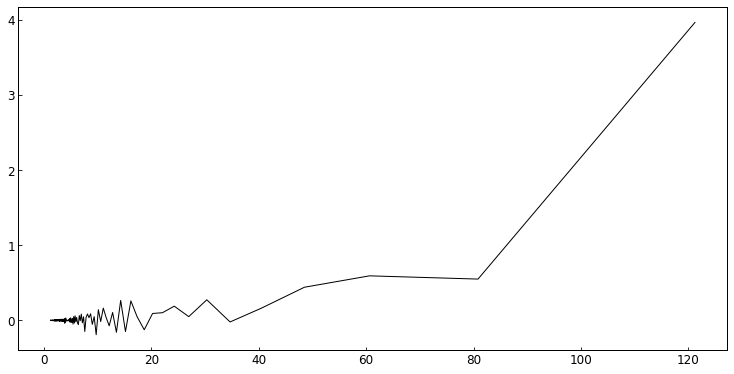

In [525]:
fig, ax = ip.general_plot(dims=dims, col=col, ft=ft)

x = edgelens3_um[:-1]
y = mge_MSr3
ax.plot(x, y, color='k', lw=lw)
# ax.set_ylim(-1,1)

log log distribution of counts

In [978]:
np.max([np.max(N) for N in mge_Nir3])

405

In [990]:
count_range

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [988]:
mge_meshs_gt = []
count_max = np.max([np.max(N) for N in mge_Nir3])
count_range = np.arange(0, count_max)
for Nir in mge_Nir3:
    gts = []
    for c in count_range:
        n_gt = np.sum(Nir >= c) / len(Nir)
        gts.append(n_gt)
    mge_meshs_gt.append(gts)

    

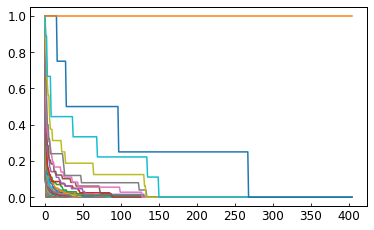

In [991]:
fig, ax = ip.general_plot()
for gts in mge_meshs_gt:
    ax.plot(count_range, gts)

In [995]:
count_range[mask]

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80])

/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in log10
  import sys
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in log10
  import sys
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in log10
  import sys
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in log10
  import sys
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in log10
  import sys
/home/bmg224/miniconda3/envs/hiprfish_pysal/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in log10
  import sys
/home/bmg224/miniconda3/envs

Text(0, 0.5, 'log10(# mesh with counts >= C)')

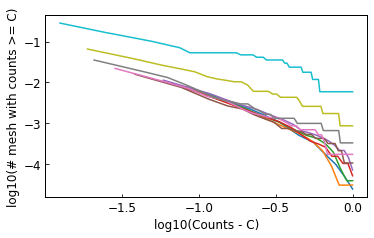

In [1008]:
fig, ax = ip.general_plot()
for gts in mge_meshs_gt[0::21]:
    gts = np.array(gts)
    mask = np.where(gts > 0)
    cr = count_range[mask]
    cr = cr / np.max(cr)
    cr = np.log10(cr)
    gts_m = np.log10(gts[mask])
    ax.plot(cr, gts_m)
# ax.set_yscale('log')
# ax.set_xscale('log')
ax.set_xlabel('log10(Counts - C)')
ax.set_ylabel('log10(# mesh with counts >= C)')


normalized

In [1011]:
mge_meshs_gtf = []
frac_range = np.linspace(0, 1, 100)
for Nir in mge_Nir3:
    gts = []
    Nir_frac = Nir / np.sum(Nir)
    for c in frac_range:
        f_gt = np.sum(Nir_frac >= c) / len(Nir)
        gts.append(f_gt)
    mge_meshs_gtf.append(gts)

    

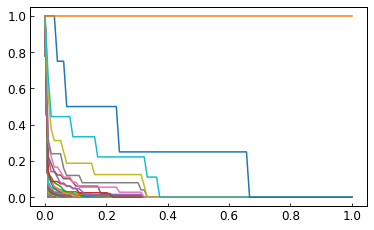

In [1014]:
fig, ax = ip.general_plot()
for gts in mge_meshs_gtf:
    ax.plot(frac_range, gts)

# ax.set_yscale('log')
# ax.set_xscale('log')

In [1032]:
[1,2,3][::-1]

[3, 2, 1]

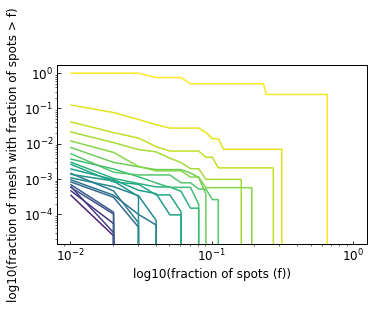

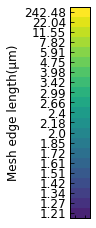

In [1053]:
subset = 10

fig, ax = ip.general_plot()
mge_meshs_gtf_sub = mge_meshs_gtf[0::subset]
color_mesh = [plt.get_cmap('viridis')(i) for i in np.linspace(0.1,1,len(mge_meshs_gtf_sub))]
for i, gts in enumerate(mge_meshs_gtf_sub):
    gts = np.array(gts)
    mask = np.where(gts > 0)
    c = color_mesh[i]
    ax.plot(frac_range[1:], gts[1:], color=c)
    # ax.plot(frac_range[mask][1:], gts[mask][1:], color=c)

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('log10(fraction of spots (f))')
ax.set_ylabel('log10(fraction of mesh with fraction of spots > f)')
plt.show()
plt.close()
fig, ax = ip.general_plot()
cbar = color_mesh[::-1]
cbar = np.array(cbar)[:,None,:]
cbar = np.hstack([cbar]*2)
ax.imshow(cbar)
ax.set_xticklabels([])
ticks = np.linspace(0,cbar.shape[0] -1,len(color_mesh))
labels = np.round(edgelens3_um[::-subset], 2)
_ = ax.set_yticks(ticks, labels=labels)
_ = ax.set_ylabel('Mesh edge length(μm)')


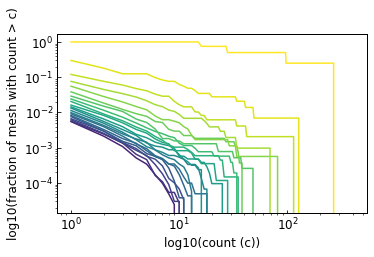

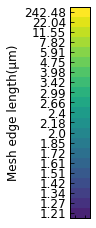

In [1054]:
subset = 10

fig, ax = ip.general_plot()
mge_meshs_gt_sub = mge_meshs_gt[0::subset]
color_mesh = [plt.get_cmap('viridis')(i) for i in np.linspace(0.1,1,len(mge_meshs_gt_sub))]
for i, gts in enumerate(mge_meshs_gt_sub):
    gts = np.array(gts)
    mask = np.where(gts > 0)
    c = color_mesh[i]
    ax.plot(count_range[1:], gts[1:], color=c)
    # ax.plot(frac_range[mask][1:], gts[mask][1:], color=c)

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('log10(count (c))')
ax.set_ylabel('log10(fraction of mesh with count > c)')
plt.show()
plt.close()
fig, ax = ip.general_plot()
cbar = color_mesh[::-1]
cbar = np.array(cbar)[:,None,:]
cbar = np.hstack([cbar]*2)
ax.imshow(cbar)
ax.set_xticklabels([])
ticks = np.linspace(0,cbar.shape[0] -1,len(color_mesh))
labels = np.round(edgelens3_um[::-subset], 2)
_ = ax.set_yticks(ticks, labels=labels)
_ = ax.set_ylabel('Mesh edge length(μm)')


## Direct clustering

Get pairwise euclidean distances for all spots

In [129]:
dist_mat_cond = pdist(mge_coords_adj_order)

In [130]:
dist_mat = squareform(dist_mat_cond)

Agglomerative clustering

In [133]:
linkage = hierarchy.linkage(dist_mat_cond, method='complete')

In [ ]:
# fig, ax = ip.general_plot(dims=(15,15))
# dn = hierarchy.dendrogram(linkage, truncate_mode=None)
# # dn = hierarchy.dendrogram(linkage, labels=inds, truncate_mode='lastp')
# # ax.axhline(t[i])
# ylims = [round(l,2) for l in ax.get_ylim()]
# ax.set_yticks(np.arange(ylims[0],ylims[1],0.1))
# ax.grid(axis='y')
# plt.show()
# plt.close()

In [154]:
n_clust = 30
agg = AgglomerativeClustering(n_clusters=n_clust, affinity='precomputed', linkage='complete')

agg.fit(dist_mat)

clust_agg = agg.labels_

In [155]:
dict_cl_sid = defaultdict(list)
for cl, sid in zip(clust_agg, spot_ids_order):
    dict_cl_sid[cl].append(sid)

Plot clusters on image

In [158]:
dict_cl_color = dict(zip(np.unique(clust_agg), list(plt.get_cmap('tab20').colors)*2))

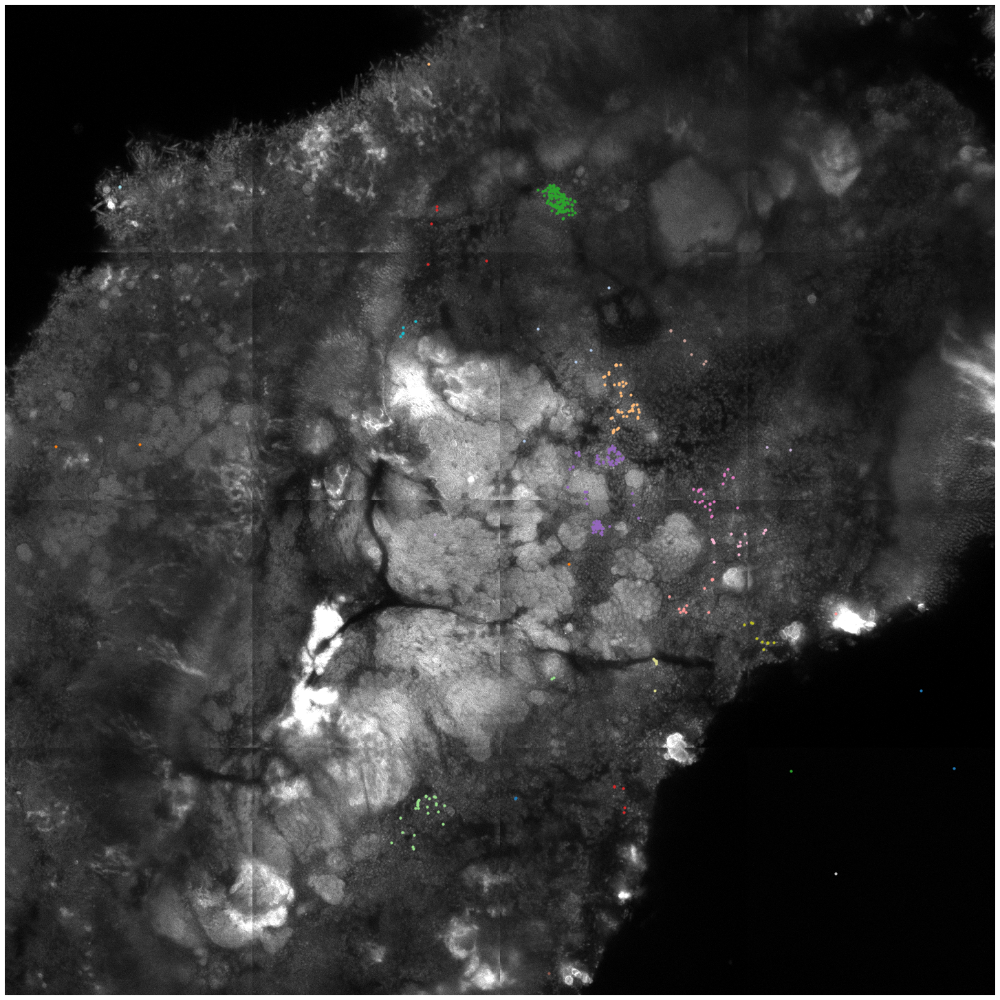

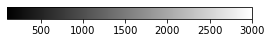

In [160]:
size = 10

fig, axs, cbars = subplot_square_images(cell_raws, (4,4), clims=(clims_cell), cmaps=cmaps_cell)
for m, ax in enumerate(axs):
    for cl, sids in dict_cl_sid.items():
        color = dict_cl_color[cl]
        c = []
        for s in sids:
            try:
                c.append(dict_m_sid_crd[m][s])
            except:
                pass
        c = np.array(c)
        if len(c) > 0:
            c = c if len(c.shape) > 1 else c[None,:]
            ax.scatter(c[:,1], c[:,0], color=color, s=size)

for i, c in enumerate(cbars):
    if i > 0:
        plt.figure(c)
        plt.close()

Measure cluster size

distance between clusters

In [902]:
a = 0
n = 0
while a < 1:
    print(n,end='\r')
    # sleep(0.5)
    n += 1

328335

KeyboardInterrupt: 